# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [2]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Extracting mnist: 100%|████████████████████████████████████████████████████████| 60.0k/60.0k [00:37<00:00, 1.61kFile/s]


Extracting celeba...


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

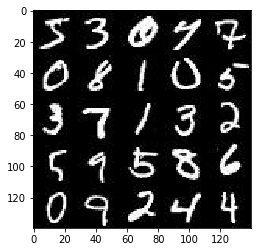

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

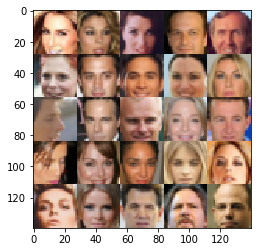

In [6]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [7]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.1.0


c:\users\jonat\anaconda3\envs\dl-py35\lib\site-packages\ipykernel\__main__.py:14: UserWarning: No GPU found. Please use a GPU to train your neural network.


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [49]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function

    return (
        tf.placeholder(tf.float32, (None, image_width, image_height, image_channels), 'imput_real'),
        tf.placeholder(tf.float32, (None, z_dim), 'imput_z'),
        tf.placeholder(tf.float32, None, 'learning_rate')
    )


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [65]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    def leak_relu(x):
        return tf.maximum(x * 0.1, x)
    
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input 28 X 28 X 3
        l1 = tf.layers.conv2d(images, 128, 5, strides=2, padding='same')
        l1 = leak_relu(l1)
        
        l2 = tf.layers.conv2d(l1, 256, 5, strides=2, padding='same')
        l2 = tf.layers.batch_normalization(l2, training=True)
        l2 = leak_relu(l2)
        
        l3 = tf.layers.conv2d(l2, 512, 5, strides=2, padding='same')
        l3 = tf.layers.batch_normalization(l3, training=True)
        l3 = leak_relu(l3)
        
        l4 = tf.layers.conv2d(l3, 1024, 5, strides=2, padding='same')
        l4 = tf.layers.batch_normalization(l4, training=True)
        l4 = leak_relu(l4)
        
        reshaped = tf.reshape(l4, (-1, 4*4*1024))
        logits = tf.layers.dense(reshaped, 1)
        out = tf.sigmoid(logits)
    
    return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [66]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    def leak_relu(x):
        return tf.maximum(x * 0.1, x)
    
    with tf.variable_scope('generator', reuse= not is_train):
        
        l1 = tf.layers.dense(z, 4*4*1024)
        l1 = tf.reshape(l1, (-1, 4, 4, 1024))
        l1 = tf.layers.batch_normalization(l1, training=is_train)
        l1 = leak_relu(l1)
        
        l2 = tf.layers.conv2d_transpose(l1, 512, 5, strides=1, padding='same')
        l2 = tf.layers.batch_normalization(l2, training=is_train)
        l2 = leak_relu(l2)
        
        l3 = tf.layers.conv2d_transpose(l2, 256, 5, strides=2, padding='same')
        l3 = tf.layers.batch_normalization(l3, training=is_train)
        l3 = leak_relu(l3)
        
        l4 = tf.layers.conv2d_transpose(l3, 128, 5, strides=1, padding='valid')
        l4 = tf.layers.batch_normalization(l4, training=is_train)
        l4 = leak_relu(l4)
        
        l5 = tf.layers.conv2d_transpose(l4, 64, 5, strides=2, padding='same')
        l5 = tf.layers.batch_normalization(l5, training=is_train)
        l5 = leak_relu(l5)
    
        logits = tf.layers.conv2d_transpose(l5, out_channel_dim, 5, strides=1, padding='valid')
    
        out = tf.tanh(logits)
    
    return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [67]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    
    g_model = generator(input_z, out_channel_dim)
    
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)
    
    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [68]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [69]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [70]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    input_real, input_z, learn_rate = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[3])
    d_opt, g_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    
    count = 0
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                count += 1
                
                batch_images *= 2
                
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                
                sess.run(d_opt, feed_dict={input_real: batch_images, input_z: batch_z, learn_rate: learning_rate})
                sess.run(g_opt, feed_dict={input_real: batch_images, input_z: batch_z, learn_rate: learning_rate})
                
                if count % 10 == 0:
                    _d_loss = d_loss.eval({input_real: batch_images, input_z: batch_z})
                    _g_loss = g_loss.eval({input_real: batch_images, input_z: batch_z})
                    
                    print("Epoch {}/{}  ".format(epoch_i + 1, epoch_count),
                          "Disc Loss: {:.5f}   ".format(_d_loss),
                          "Gen Loss: {:.5f}".format(_g_loss))
                    
                    show_generator_output(sess, 25, input_z, data_shape[3], data_image_mode)

                


### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/2   Disc Loss: 0.00986    Gen Loss: 9.48548


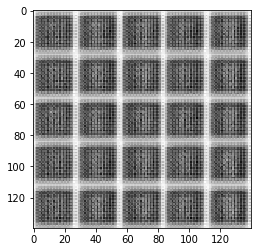

Epoch 1/2   Disc Loss: 0.00205    Gen Loss: 8.33303


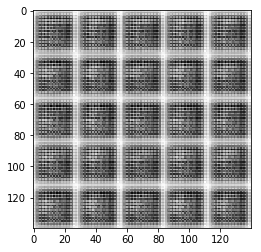

Epoch 1/2   Disc Loss: 0.00087    Gen Loss: 16.34170


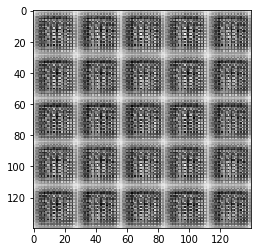

Epoch 1/2   Disc Loss: 0.00045    Gen Loss: 11.84472


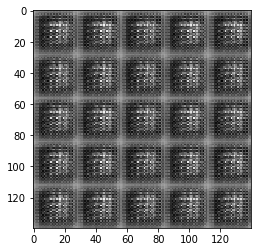

Epoch 1/2   Disc Loss: 0.15320    Gen Loss: 15.36876


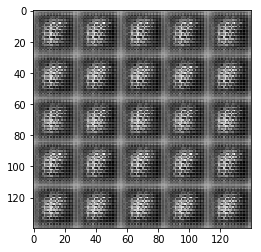

Epoch 1/2   Disc Loss: 0.03614    Gen Loss: 4.23063


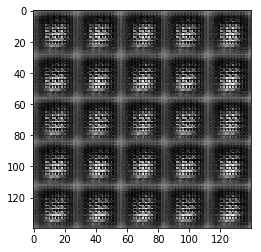

Epoch 1/2   Disc Loss: 0.00036    Gen Loss: 10.69776


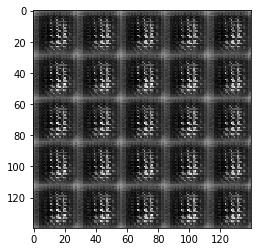

Epoch 1/2   Disc Loss: 0.00340    Gen Loss: 15.44709


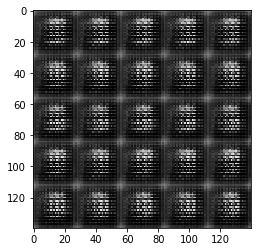

Epoch 1/2   Disc Loss: 0.08659    Gen Loss: 3.81457


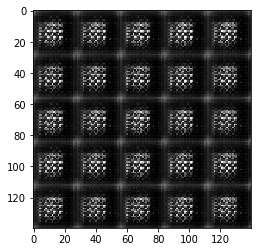

Epoch 1/2   Disc Loss: 0.04191    Gen Loss: 6.42648


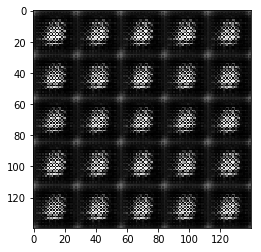

Epoch 1/2   Disc Loss: 0.00296    Gen Loss: 8.77352


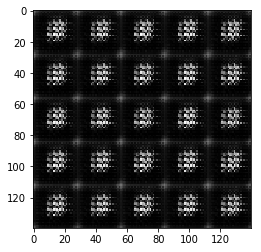

Epoch 1/2   Disc Loss: 0.07072    Gen Loss: 7.78960


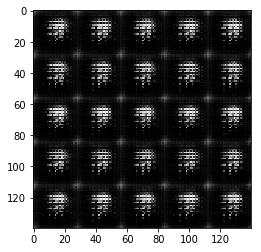

Epoch 1/2   Disc Loss: 0.09423    Gen Loss: 7.51073


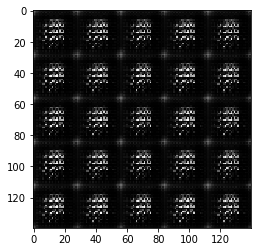

Epoch 1/2   Disc Loss: 0.00285    Gen Loss: 7.06593


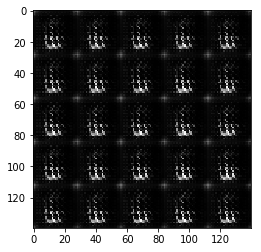

Epoch 1/2   Disc Loss: 1.44316    Gen Loss: 0.27662


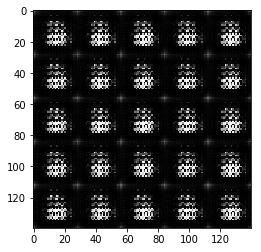

Epoch 1/2   Disc Loss: 0.12751    Gen Loss: 2.15017


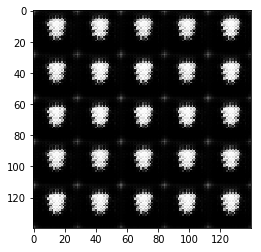

Epoch 1/2   Disc Loss: 0.04962    Gen Loss: 11.05900


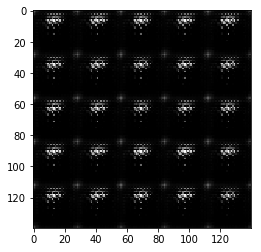

Epoch 1/2   Disc Loss: 0.05139    Gen Loss: 6.77557


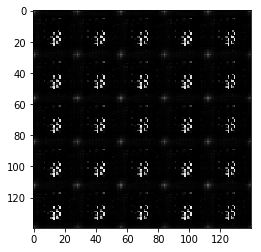

Epoch 1/2   Disc Loss: 0.05580    Gen Loss: 3.39756


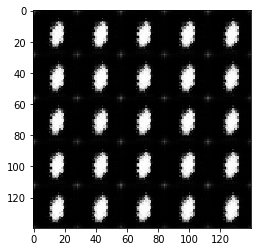

Epoch 1/2   Disc Loss: 0.06585    Gen Loss: 3.48993


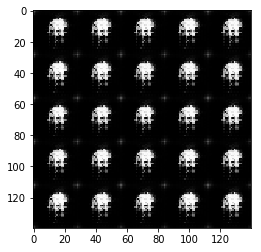

Epoch 1/2   Disc Loss: 3.12099    Gen Loss: 0.04613


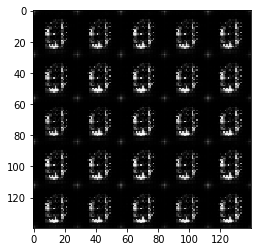

Epoch 1/2   Disc Loss: 4.95020    Gen Loss: 0.00725


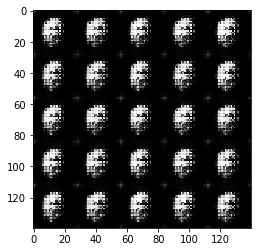

Epoch 1/2   Disc Loss: 0.08980    Gen Loss: 3.04789


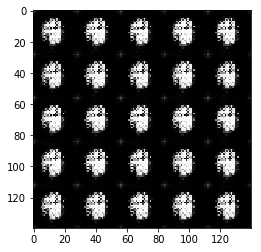

Epoch 1/2   Disc Loss: 0.13846    Gen Loss: 13.45296


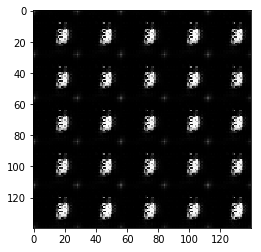

Epoch 1/2   Disc Loss: 0.01954    Gen Loss: 5.03415


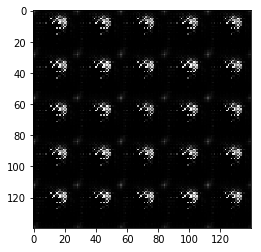

Epoch 1/2   Disc Loss: 0.13232    Gen Loss: 2.26114


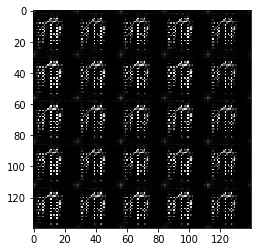

Epoch 1/2   Disc Loss: 0.04729    Gen Loss: 3.72513


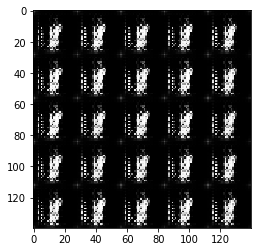

Epoch 1/2   Disc Loss: 0.05413    Gen Loss: 3.77491


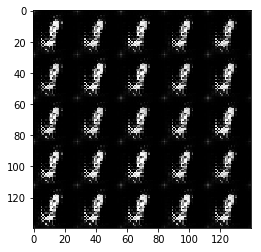

Epoch 1/2   Disc Loss: 0.03138    Gen Loss: 5.67997


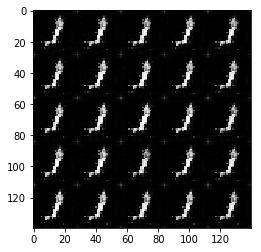

Epoch 1/2   Disc Loss: 0.04544    Gen Loss: 3.30441


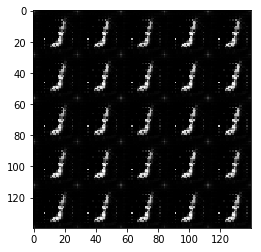

Epoch 1/2   Disc Loss: 0.01675    Gen Loss: 4.75974


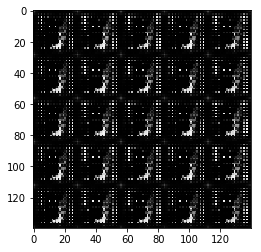

Epoch 1/2   Disc Loss: 0.32479    Gen Loss: 1.32812


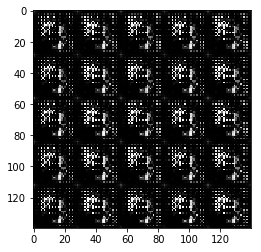

Epoch 1/2   Disc Loss: 0.07617    Gen Loss: 2.75671


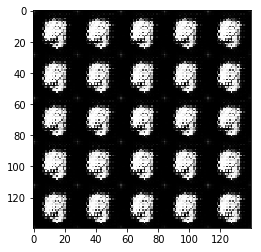

Epoch 1/2   Disc Loss: 0.04306    Gen Loss: 8.66647


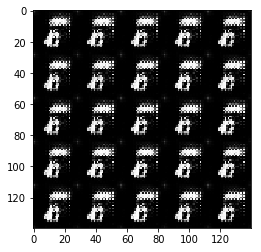

Epoch 1/2   Disc Loss: 0.01228    Gen Loss: 13.31178


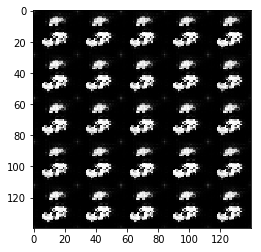

Epoch 1/2   Disc Loss: 0.05016    Gen Loss: 3.54318


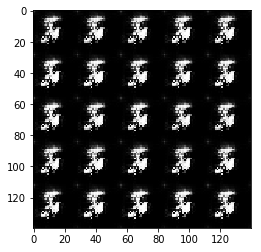

Epoch 1/2   Disc Loss: 0.29477    Gen Loss: 1.42924


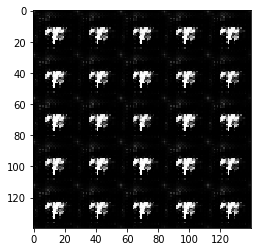

Epoch 1/2   Disc Loss: 0.01804    Gen Loss: 4.96731


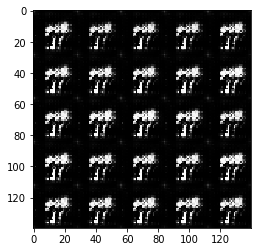

Epoch 1/2   Disc Loss: 0.01350    Gen Loss: 4.95032


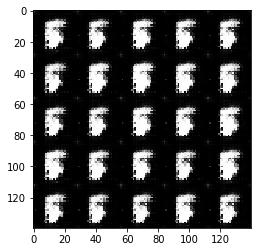

Epoch 1/2   Disc Loss: 0.51411    Gen Loss: 1.10269


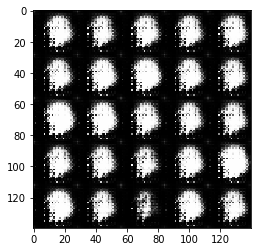

Epoch 1/2   Disc Loss: 1.10816    Gen Loss: 8.59076


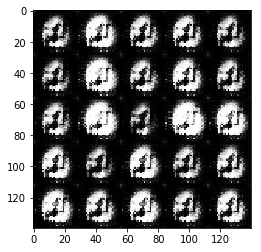

Epoch 1/2   Disc Loss: 0.04164    Gen Loss: 5.04604


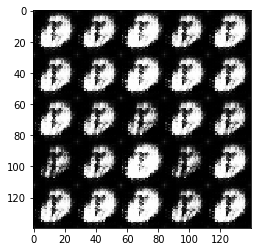

Epoch 1/2   Disc Loss: 1.55171    Gen Loss: 7.76321


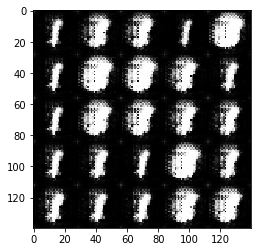

Epoch 1/2   Disc Loss: 0.05124    Gen Loss: 7.57917


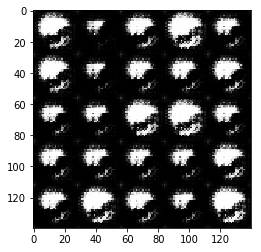

Epoch 1/2   Disc Loss: 1.20587    Gen Loss: 0.53013


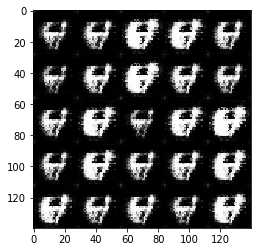

Epoch 1/2   Disc Loss: 0.30335    Gen Loss: 2.19864


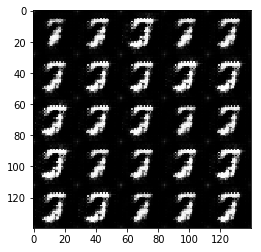

Epoch 1/2   Disc Loss: 0.75796    Gen Loss: 0.95635


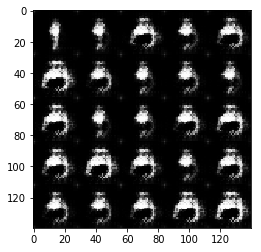

Epoch 1/2   Disc Loss: 0.64761    Gen Loss: 1.21394


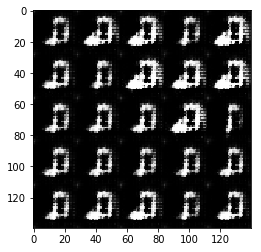

Epoch 1/2   Disc Loss: 0.49747    Gen Loss: 1.38406


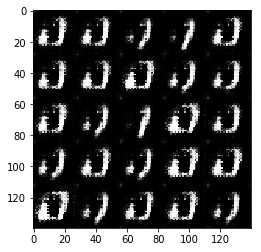

Epoch 1/2   Disc Loss: 0.91829    Gen Loss: 0.80601


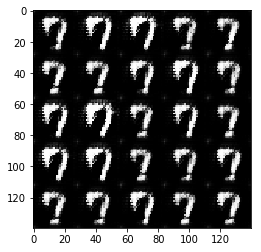

Epoch 1/2   Disc Loss: 0.47466    Gen Loss: 1.61775


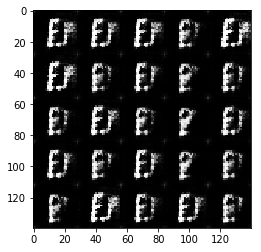

Epoch 1/2   Disc Loss: 0.16223    Gen Loss: 2.83865


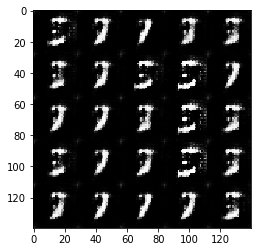

Epoch 1/2   Disc Loss: 0.52770    Gen Loss: 1.19583


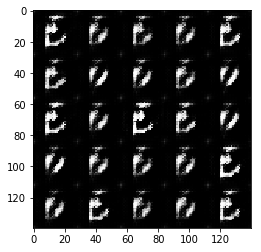

Epoch 1/2   Disc Loss: 0.62076    Gen Loss: 1.07791


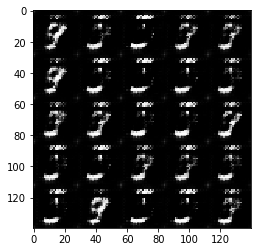

Epoch 1/2   Disc Loss: 0.04856    Gen Loss: 8.19689


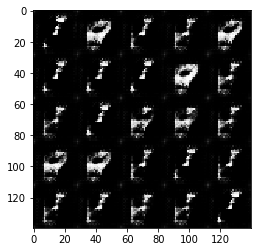

Epoch 1/2   Disc Loss: 0.35384    Gen Loss: 1.52292


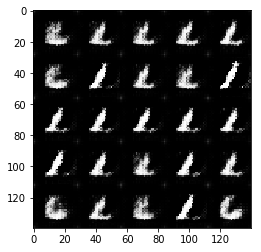

Epoch 1/2   Disc Loss: 0.02855    Gen Loss: 6.41499


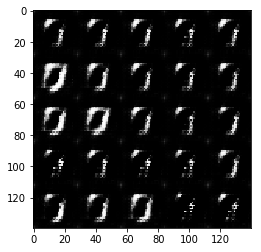

Epoch 1/2   Disc Loss: 2.50856    Gen Loss: 0.10644


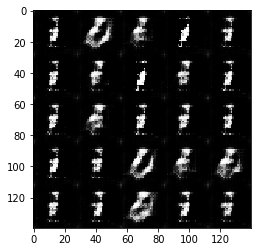

Epoch 1/2   Disc Loss: 0.10665    Gen Loss: 4.07542


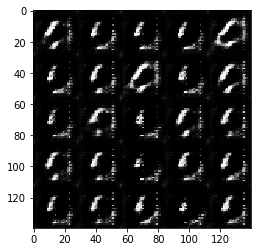

Epoch 1/2   Disc Loss: 0.56510    Gen Loss: 0.97575


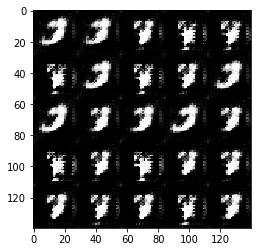

Epoch 1/2   Disc Loss: 0.20799    Gen Loss: 2.18493


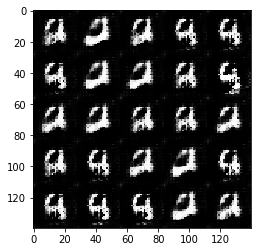

Epoch 1/2   Disc Loss: 0.58834    Gen Loss: 1.65579


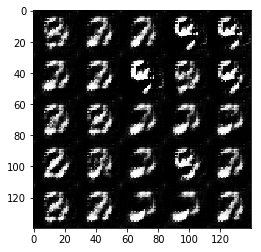

Epoch 1/2   Disc Loss: 1.23960    Gen Loss: 0.45947


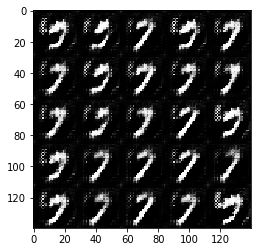

Epoch 1/2   Disc Loss: 0.14761    Gen Loss: 5.14843


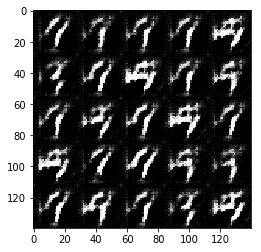

Epoch 1/2   Disc Loss: 0.97544    Gen Loss: 0.58633


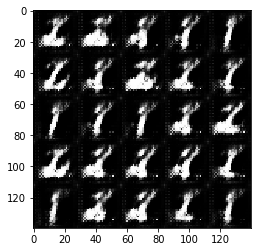

Epoch 1/2   Disc Loss: 0.54294    Gen Loss: 1.40116


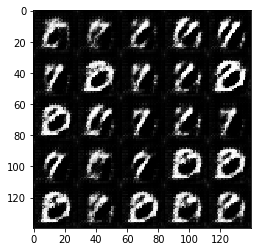

Epoch 1/2   Disc Loss: 1.14013    Gen Loss: 0.71170


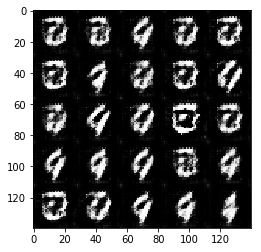

Epoch 1/2   Disc Loss: 0.20028    Gen Loss: 2.98011


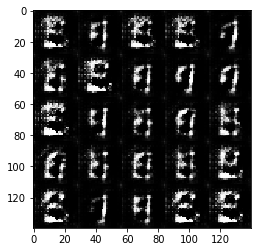

Epoch 1/2   Disc Loss: 0.20724    Gen Loss: 2.02972


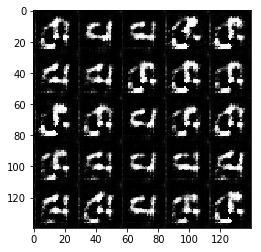

Epoch 1/2   Disc Loss: 0.31861    Gen Loss: 5.49234


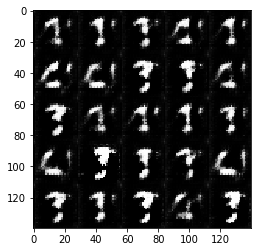

Epoch 1/2   Disc Loss: 2.09866    Gen Loss: 0.17303


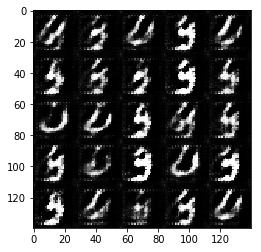

Epoch 1/2   Disc Loss: 0.30575    Gen Loss: 1.79051


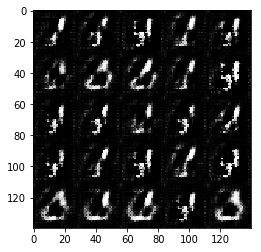

Epoch 1/2   Disc Loss: 0.40307    Gen Loss: 1.52256


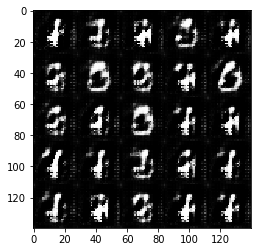

Epoch 1/2   Disc Loss: 0.20855    Gen Loss: 4.24656


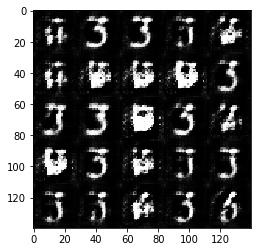

Epoch 1/2   Disc Loss: 1.47534    Gen Loss: 7.80359


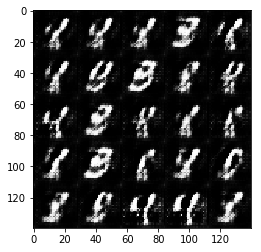

Epoch 1/2   Disc Loss: 0.71375    Gen Loss: 1.10200


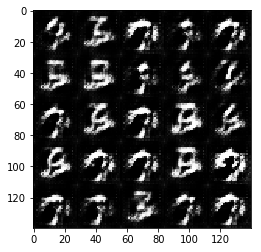

Epoch 1/2   Disc Loss: 0.63167    Gen Loss: 3.23737


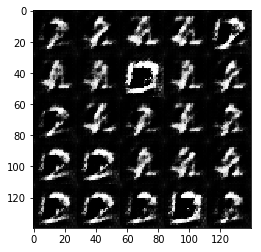

Epoch 1/2   Disc Loss: 0.87102    Gen Loss: 0.94114


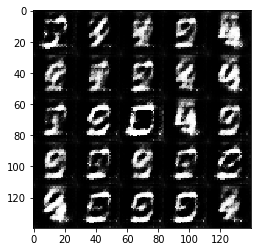

Epoch 1/2   Disc Loss: 0.44992    Gen Loss: 1.69741


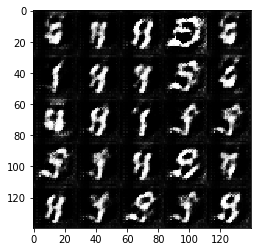

Epoch 1/2   Disc Loss: 0.57517    Gen Loss: 1.09396


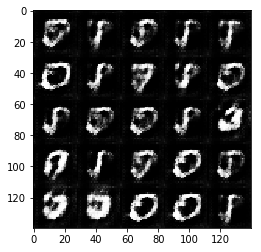

Epoch 1/2   Disc Loss: 0.44361    Gen Loss: 2.42046


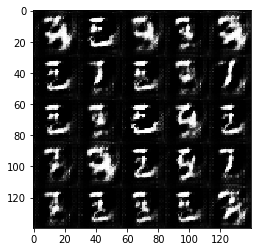

Epoch 1/2   Disc Loss: 0.84193    Gen Loss: 1.03330


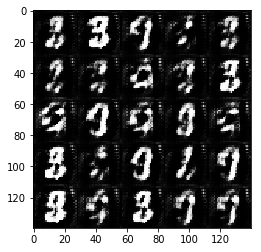

Epoch 1/2   Disc Loss: 0.35669    Gen Loss: 5.67436


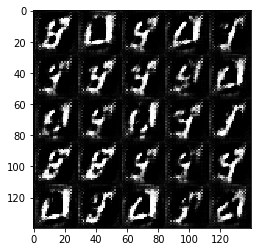

Epoch 1/2   Disc Loss: 0.53958    Gen Loss: 7.11004


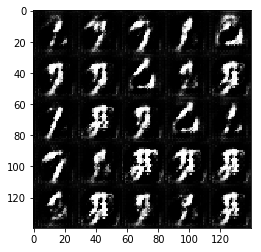

Epoch 1/2   Disc Loss: 1.06432    Gen Loss: 0.55683


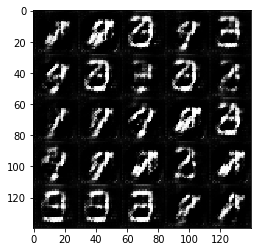

Epoch 1/2   Disc Loss: 1.01658    Gen Loss: 0.56596


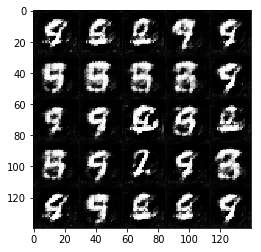

Epoch 1/2   Disc Loss: 0.78384    Gen Loss: 4.05245


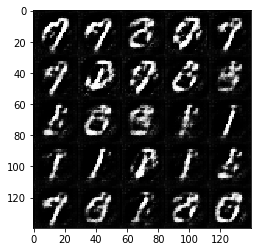

Epoch 1/2   Disc Loss: 0.22079    Gen Loss: 2.03477


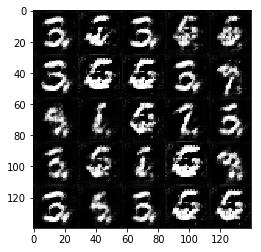

Epoch 1/2   Disc Loss: 1.08009    Gen Loss: 0.59079


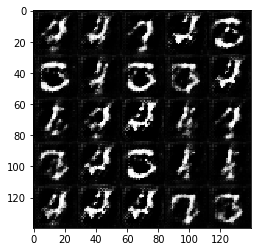

Epoch 1/2   Disc Loss: 0.25554    Gen Loss: 2.37439


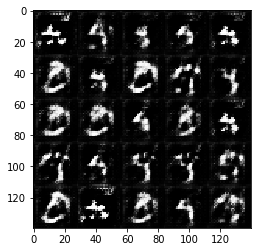

Epoch 1/2   Disc Loss: 0.89461    Gen Loss: 0.81596


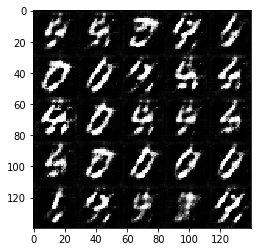

Epoch 1/2   Disc Loss: 0.29641    Gen Loss: 4.86071


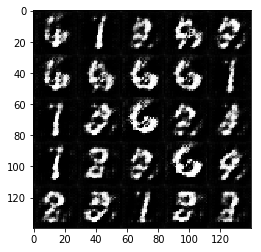

Epoch 1/2   Disc Loss: 1.02943    Gen Loss: 0.93487


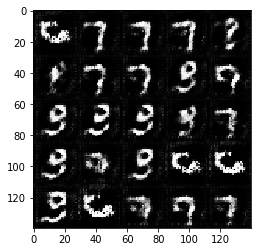

Epoch 2/2   Disc Loss: 0.49418    Gen Loss: 1.19763


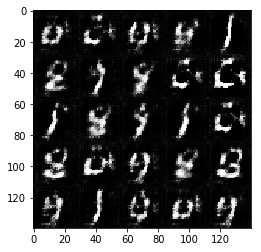

Epoch 2/2   Disc Loss: 0.28483    Gen Loss: 2.37619


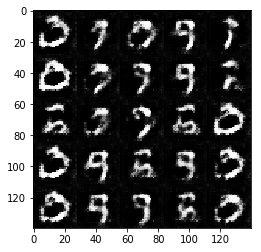

Epoch 2/2   Disc Loss: 0.66159    Gen Loss: 0.92483


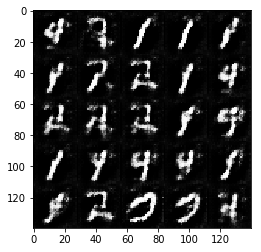

Epoch 2/2   Disc Loss: 0.28678    Gen Loss: 2.10957


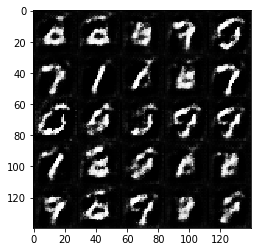

Epoch 2/2   Disc Loss: 0.46073    Gen Loss: 1.71170


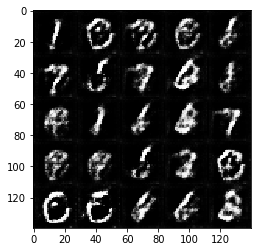

Epoch 2/2   Disc Loss: 0.40015    Gen Loss: 2.32843


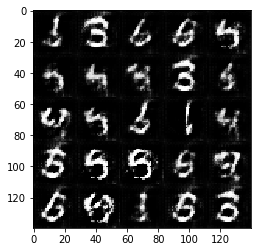

Epoch 2/2   Disc Loss: 0.11935    Gen Loss: 3.96911


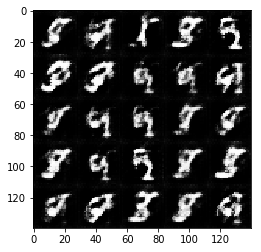

Epoch 2/2   Disc Loss: 0.75531    Gen Loss: 1.36232


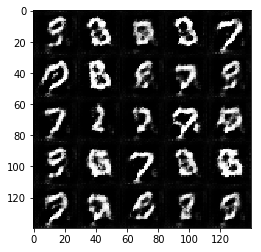

Epoch 2/2   Disc Loss: 0.40201    Gen Loss: 1.57346


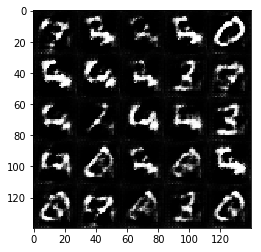

Epoch 2/2   Disc Loss: 0.49992    Gen Loss: 1.60076


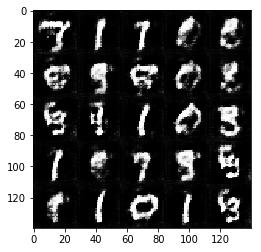

Epoch 2/2   Disc Loss: 0.63036    Gen Loss: 1.14346


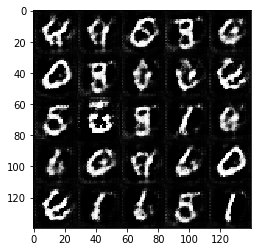

Epoch 2/2   Disc Loss: 0.47316    Gen Loss: 1.57182


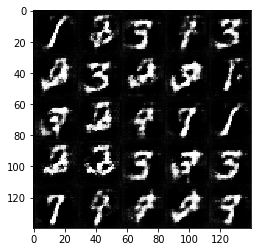

Epoch 2/2   Disc Loss: 1.34472    Gen Loss: 5.92733


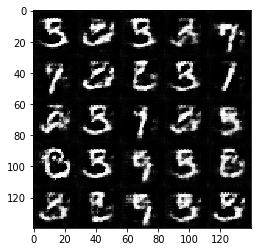

Epoch 2/2   Disc Loss: 1.34367    Gen Loss: 0.61620


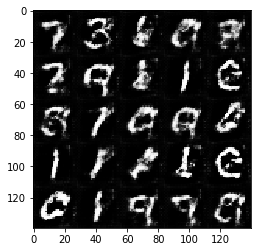

Epoch 2/2   Disc Loss: 1.62766    Gen Loss: 0.32348


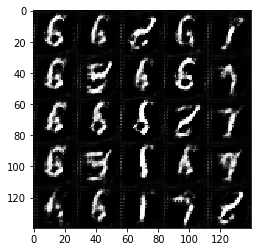

Epoch 2/2   Disc Loss: 0.88333    Gen Loss: 0.79040


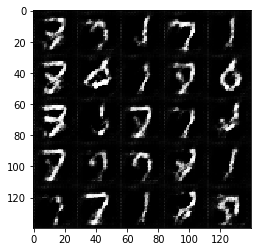

Epoch 2/2   Disc Loss: 0.59268    Gen Loss: 1.11280


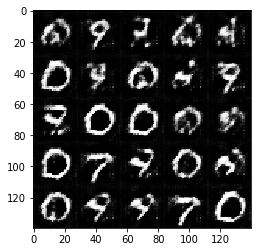

Epoch 2/2   Disc Loss: 0.32904    Gen Loss: 2.48530


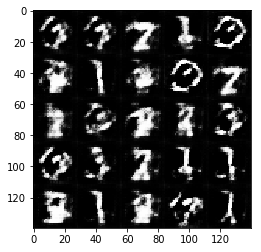

Epoch 2/2   Disc Loss: 0.56192    Gen Loss: 1.22844


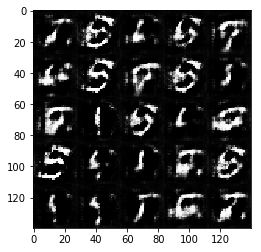

Epoch 2/2   Disc Loss: 0.47844    Gen Loss: 1.53590


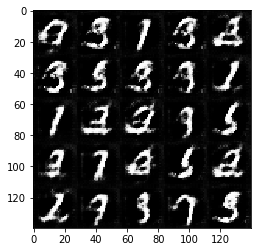

Epoch 2/2   Disc Loss: 0.48036    Gen Loss: 2.01772


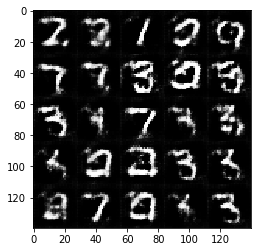

Epoch 2/2   Disc Loss: 0.58769    Gen Loss: 1.35482


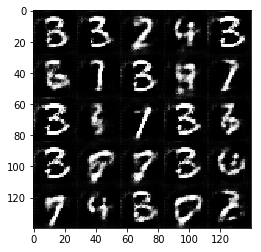

Epoch 2/2   Disc Loss: 0.80252    Gen Loss: 1.15986


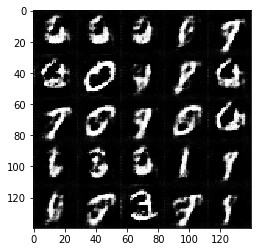

Epoch 2/2   Disc Loss: 0.42474    Gen Loss: 1.99871


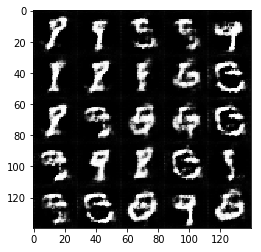

Epoch 2/2   Disc Loss: 2.37121    Gen Loss: 0.13373


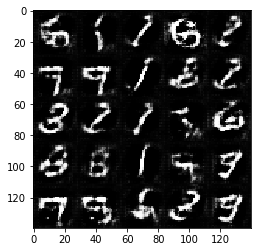

Epoch 2/2   Disc Loss: 1.20470    Gen Loss: 0.47405


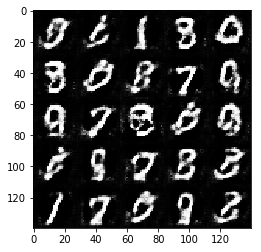

Epoch 2/2   Disc Loss: 1.17391    Gen Loss: 0.45453


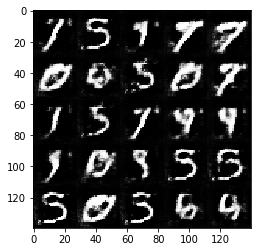

Epoch 2/2   Disc Loss: 0.94804    Gen Loss: 0.72165


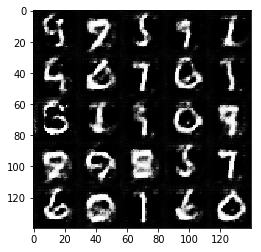

Epoch 2/2   Disc Loss: 0.68620    Gen Loss: 2.76553


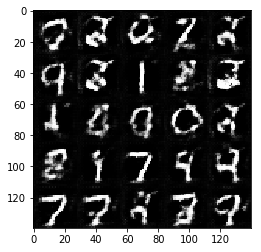

Epoch 2/2   Disc Loss: 1.04354    Gen Loss: 3.26775


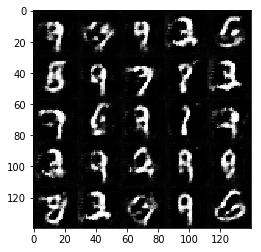

Epoch 2/2   Disc Loss: 0.91409    Gen Loss: 0.63229


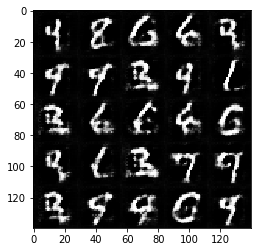

Epoch 2/2   Disc Loss: 0.93692    Gen Loss: 4.33920


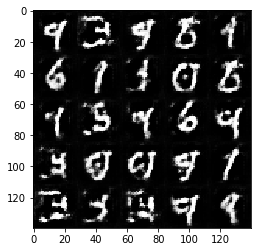

Epoch 2/2   Disc Loss: 0.83724    Gen Loss: 0.83102


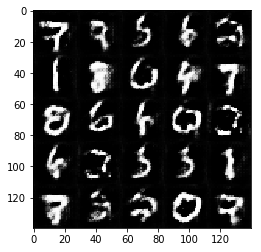

Epoch 2/2   Disc Loss: 0.69984    Gen Loss: 0.96315


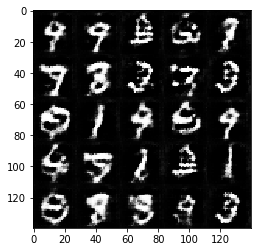

Epoch 2/2   Disc Loss: 0.80431    Gen Loss: 1.25846


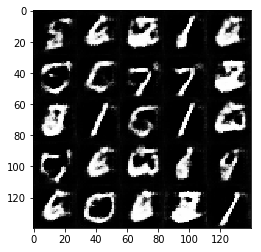

Epoch 2/2   Disc Loss: 0.39819    Gen Loss: 1.74696


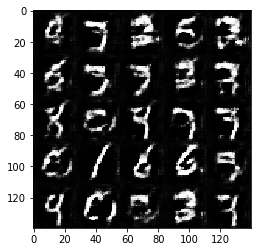

Epoch 2/2   Disc Loss: 0.69567    Gen Loss: 3.68343


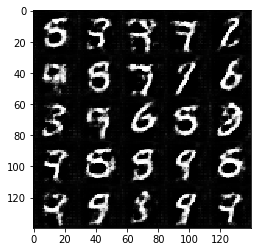

Epoch 2/2   Disc Loss: 0.62351    Gen Loss: 1.23034


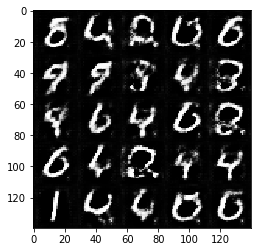

Epoch 2/2   Disc Loss: 0.54127    Gen Loss: 1.34079


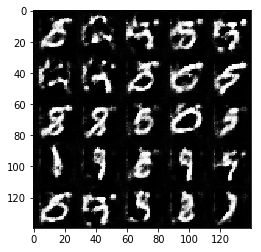

Epoch 2/2   Disc Loss: 0.51485    Gen Loss: 4.42035


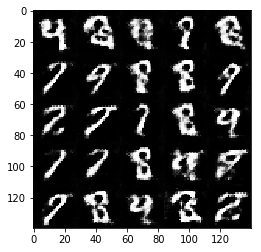

Epoch 2/2   Disc Loss: 0.73664    Gen Loss: 1.00634


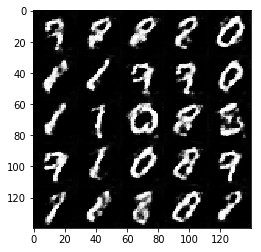

Epoch 2/2   Disc Loss: 0.59077    Gen Loss: 2.82675


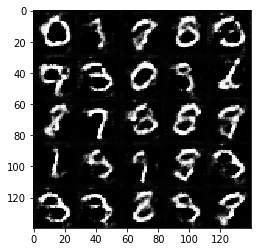

Epoch 2/2   Disc Loss: 0.77161    Gen Loss: 1.72620


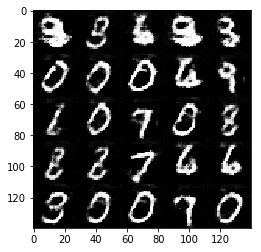

Epoch 2/2   Disc Loss: 1.15224    Gen Loss: 3.28084


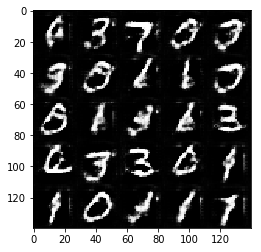

Epoch 2/2   Disc Loss: 0.53173    Gen Loss: 1.07967


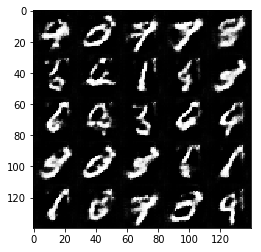

Epoch 2/2   Disc Loss: 0.39947    Gen Loss: 1.73843


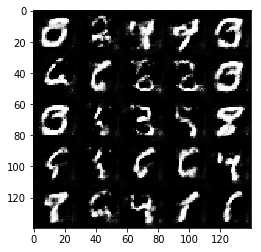

Epoch 2/2   Disc Loss: 1.10723    Gen Loss: 4.22508


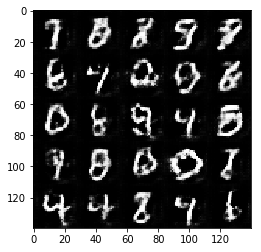

Epoch 2/2   Disc Loss: 0.66019    Gen Loss: 1.09787


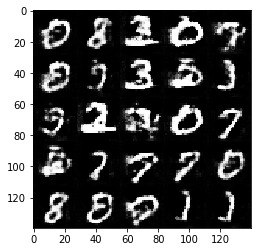

Epoch 2/2   Disc Loss: 0.69878    Gen Loss: 1.24201


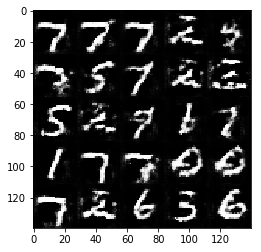

Epoch 2/2   Disc Loss: 0.66204    Gen Loss: 2.27577


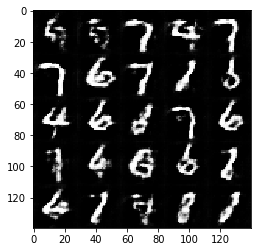

Epoch 2/2   Disc Loss: 1.20753    Gen Loss: 0.47799


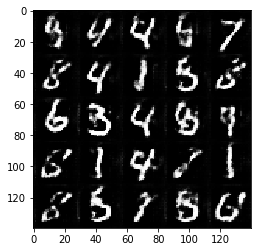

Epoch 2/2   Disc Loss: 0.92030    Gen Loss: 0.67629


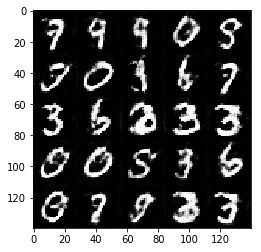

Epoch 2/2   Disc Loss: 1.49205    Gen Loss: 0.33615


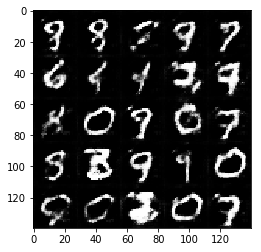

Epoch 2/2   Disc Loss: 1.28750    Gen Loss: 0.50412


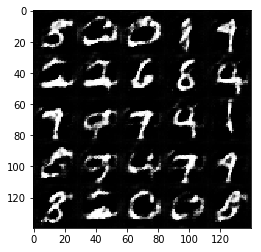

Epoch 2/2   Disc Loss: 1.05444    Gen Loss: 0.71344


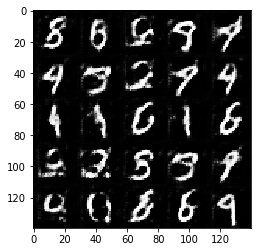

Epoch 2/2   Disc Loss: 0.60052    Gen Loss: 1.59312


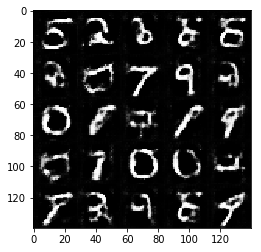

Epoch 2/2   Disc Loss: 0.73523    Gen Loss: 2.28282


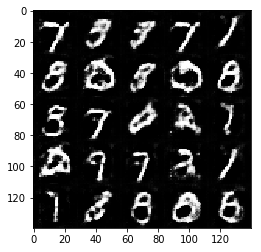

Epoch 2/2   Disc Loss: 0.50317    Gen Loss: 1.42693


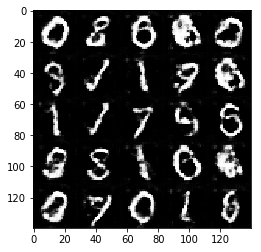

Epoch 2/2   Disc Loss: 0.60115    Gen Loss: 1.22436


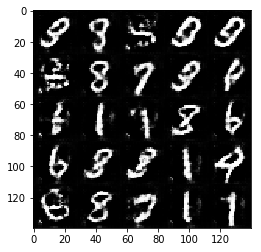

Epoch 2/2   Disc Loss: 0.44752    Gen Loss: 2.75656


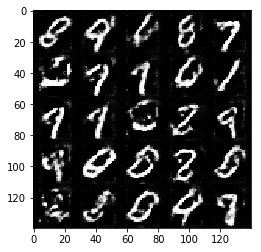

Epoch 2/2   Disc Loss: 0.50040    Gen Loss: 1.38837


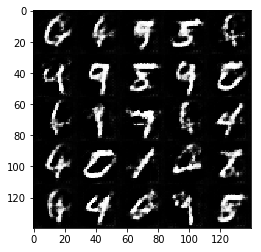

Epoch 2/2   Disc Loss: 0.51366    Gen Loss: 2.61365


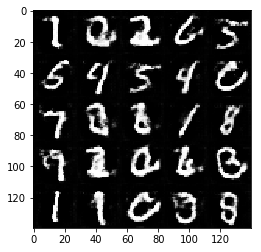

Epoch 2/2   Disc Loss: 0.99407    Gen Loss: 4.08902


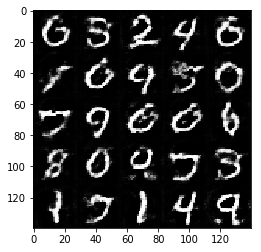

Epoch 2/2   Disc Loss: 0.67447    Gen Loss: 1.09864


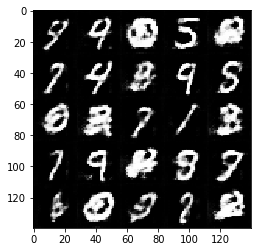

Epoch 2/2   Disc Loss: 0.66033    Gen Loss: 1.00282


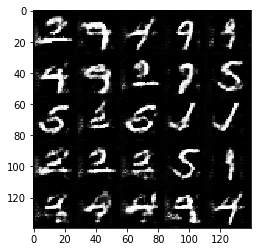

Epoch 2/2   Disc Loss: 1.36812    Gen Loss: 4.29340


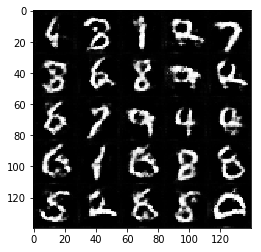

Epoch 2/2   Disc Loss: 0.55157    Gen Loss: 3.91189


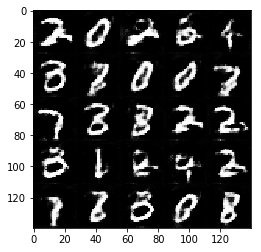

Epoch 2/2   Disc Loss: 1.15382    Gen Loss: 0.56446


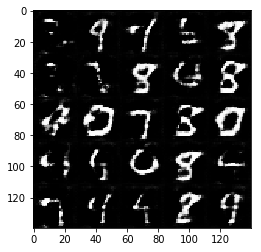

Epoch 2/2   Disc Loss: 0.54204    Gen Loss: 1.62195


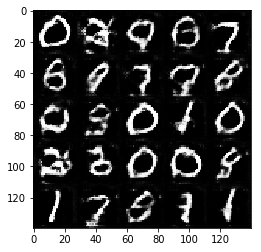

Epoch 2/2   Disc Loss: 1.52265    Gen Loss: 0.35803


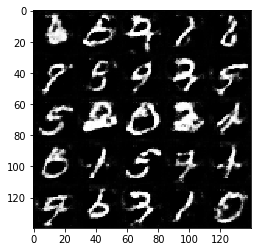

Epoch 2/2   Disc Loss: 0.49499    Gen Loss: 1.28647


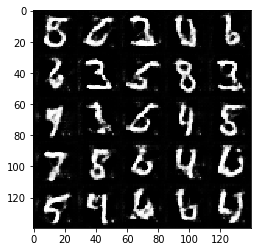

Epoch 2/2   Disc Loss: 0.89059    Gen Loss: 0.77711


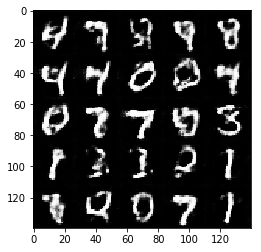

Epoch 2/2   Disc Loss: 0.67520    Gen Loss: 0.90867


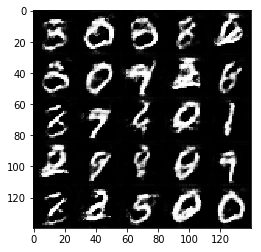

Epoch 2/2   Disc Loss: 0.93887    Gen Loss: 0.73658


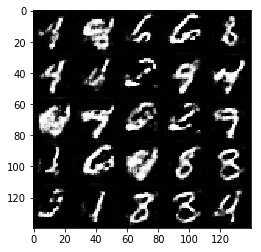

Epoch 2/2   Disc Loss: 0.57526    Gen Loss: 1.47885


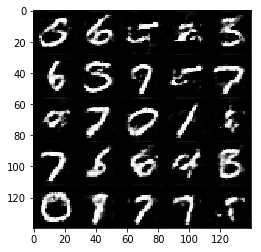

Epoch 2/2   Disc Loss: 0.67428    Gen Loss: 2.14017


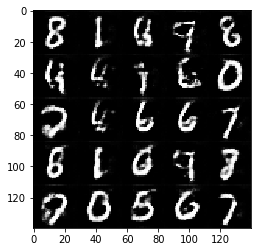

Epoch 2/2   Disc Loss: 0.98606    Gen Loss: 0.59931


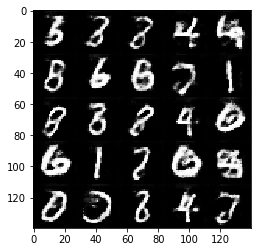

Epoch 2/2   Disc Loss: 0.32577    Gen Loss: 2.84216


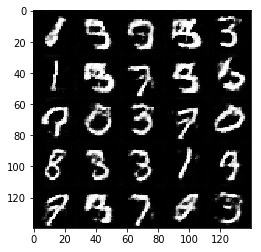

Epoch 2/2   Disc Loss: 0.70527    Gen Loss: 1.03523


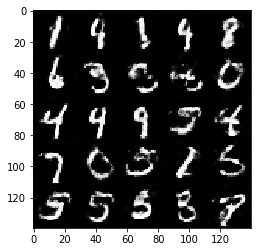

Epoch 2/2   Disc Loss: 0.73011    Gen Loss: 2.10046


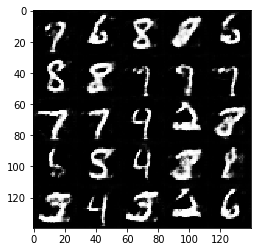

Epoch 2/2   Disc Loss: 1.29740    Gen Loss: 0.38527


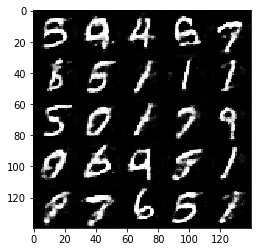

Epoch 2/2   Disc Loss: 0.51835    Gen Loss: 1.77481


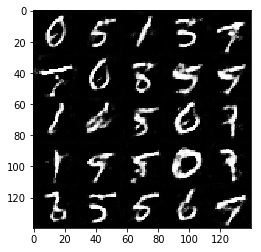

Epoch 2/2   Disc Loss: 0.53068    Gen Loss: 1.51597


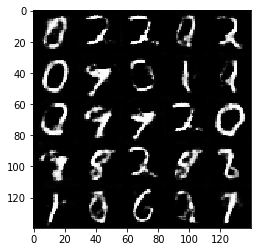

Epoch 2/2   Disc Loss: 0.52603    Gen Loss: 2.48648


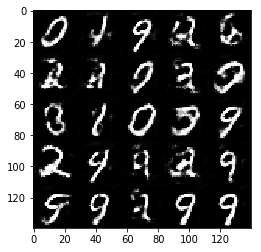

Epoch 2/2   Disc Loss: 0.59445    Gen Loss: 1.12226


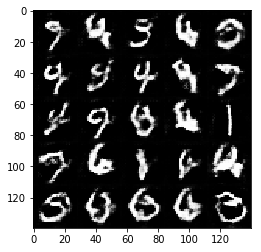

Epoch 2/2   Disc Loss: 0.58131    Gen Loss: 1.69998


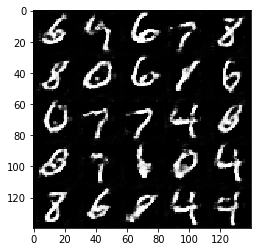

Epoch 2/2   Disc Loss: 0.45125    Gen Loss: 1.77526


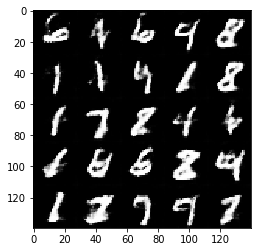

Epoch 2/2   Disc Loss: 0.69010    Gen Loss: 0.86405


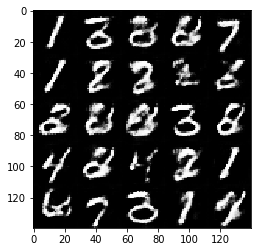

Epoch 2/2   Disc Loss: 0.49056    Gen Loss: 1.47138


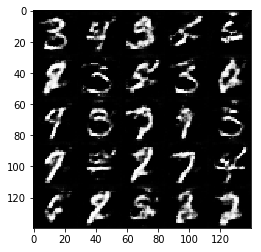

Epoch 2/2   Disc Loss: 0.29724    Gen Loss: 1.96596


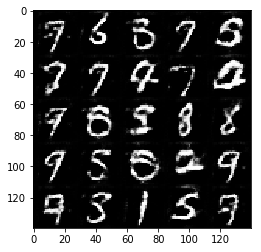

Epoch 2/2   Disc Loss: 0.40925    Gen Loss: 1.83144


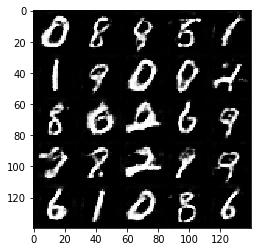

Epoch 2/2   Disc Loss: 0.76330    Gen Loss: 0.81070


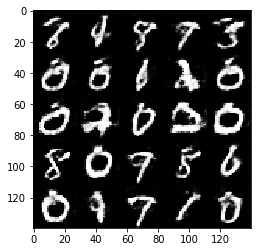

Epoch 2/2   Disc Loss: 1.03654    Gen Loss: 2.41575


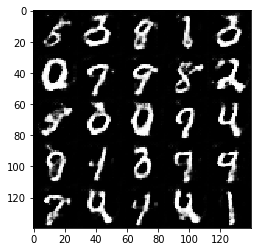

Epoch 2/2   Disc Loss: 0.65890    Gen Loss: 0.92151


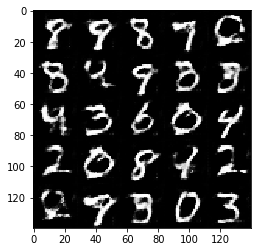

In [71]:
batch_size = 64
z_dim = 100
learning_rate = 0.0001
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/1   Disc Loss: 3.36680    Gen Loss: 0.04307


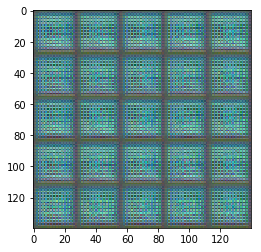

Epoch 1/1   Disc Loss: 0.00003    Gen Loss: 17.01558


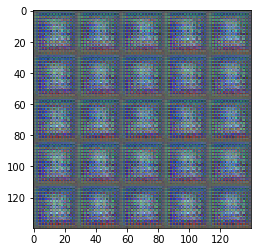

Epoch 1/1   Disc Loss: 0.00050    Gen Loss: 15.77926


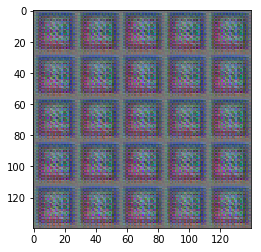

Epoch 1/1   Disc Loss: 0.93877    Gen Loss: 21.73559


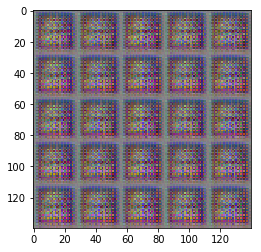

Epoch 1/1   Disc Loss: 0.00049    Gen Loss: 9.04186


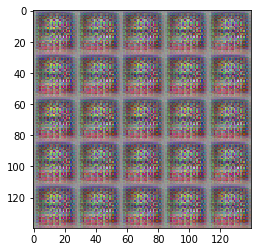

Epoch 1/1   Disc Loss: 0.42125    Gen Loss: 14.85197


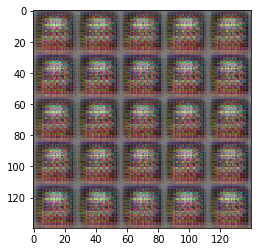

Epoch 1/1   Disc Loss: 0.03705    Gen Loss: 3.33406


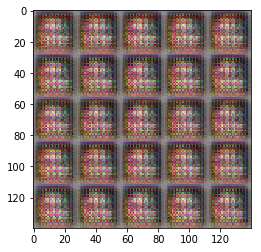

Epoch 1/1   Disc Loss: 0.00859    Gen Loss: 11.50702


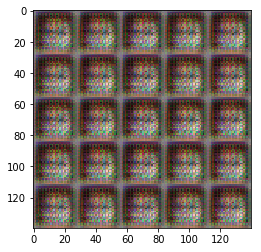

Epoch 1/1   Disc Loss: 0.18586    Gen Loss: 13.58441


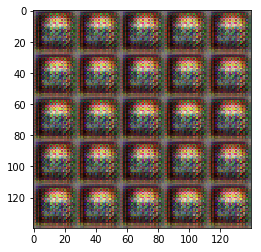

Epoch 1/1   Disc Loss: 0.01613    Gen Loss: 6.27640


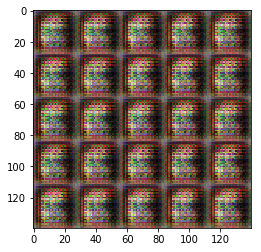

Epoch 1/1   Disc Loss: 0.03320    Gen Loss: 4.96792


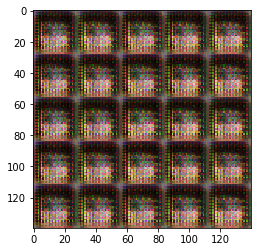

Epoch 1/1   Disc Loss: 0.03880    Gen Loss: 11.08971


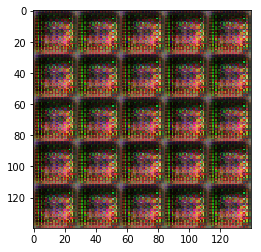

Epoch 1/1   Disc Loss: 0.77614    Gen Loss: 5.54069


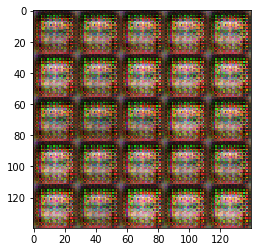

Epoch 1/1   Disc Loss: 1.18855    Gen Loss: 4.98638


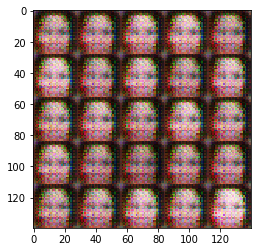

Epoch 1/1   Disc Loss: 0.18313    Gen Loss: 3.38340


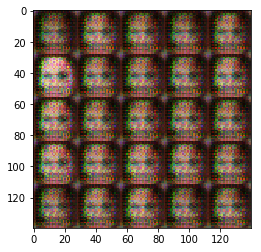

Epoch 1/1   Disc Loss: 0.74284    Gen Loss: 0.83669


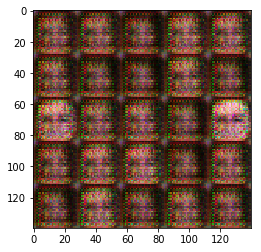

Epoch 1/1   Disc Loss: 0.19927    Gen Loss: 3.43894


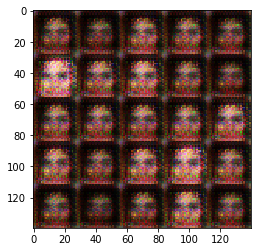

Epoch 1/1   Disc Loss: 0.19591    Gen Loss: 2.56510


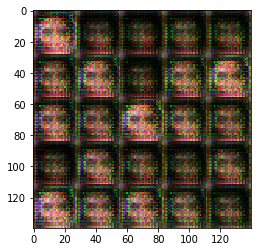

Epoch 1/1   Disc Loss: 0.33142    Gen Loss: 1.91212


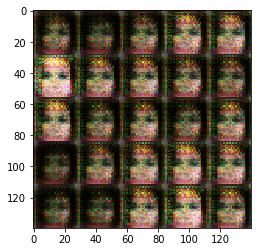

Epoch 1/1   Disc Loss: 2.82613    Gen Loss: 10.25822


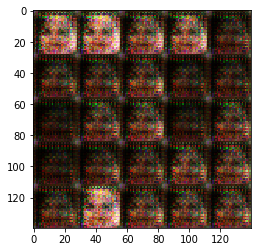

Epoch 1/1   Disc Loss: 0.27750    Gen Loss: 1.93315


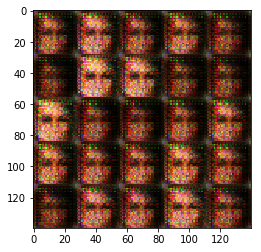

Epoch 1/1   Disc Loss: 0.51549    Gen Loss: 1.15560


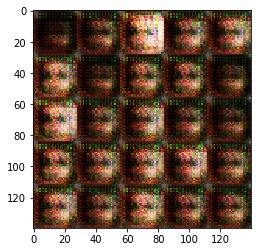

Epoch 1/1   Disc Loss: 0.95387    Gen Loss: 0.58853


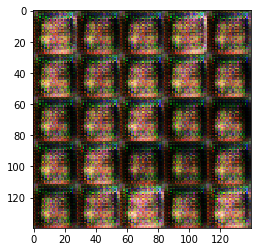

Epoch 1/1   Disc Loss: 0.61871    Gen Loss: 1.09586


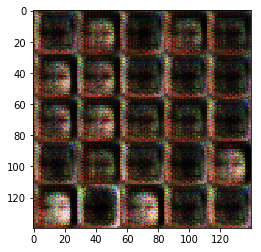

Epoch 1/1   Disc Loss: 0.10911    Gen Loss: 3.39972


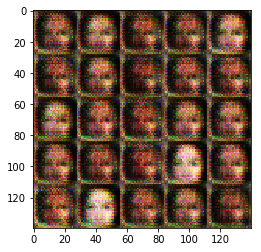

Epoch 1/1   Disc Loss: 1.84148    Gen Loss: 0.34718


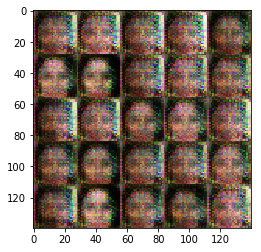

Epoch 1/1   Disc Loss: 0.16808    Gen Loss: 3.98169


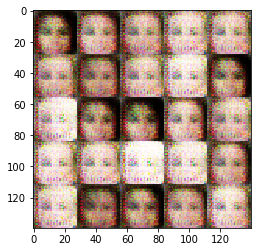

Epoch 1/1   Disc Loss: 0.78534    Gen Loss: 1.99891


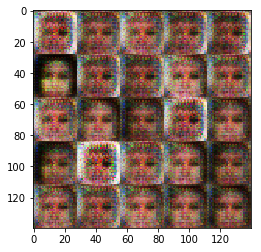

Epoch 1/1   Disc Loss: 0.74035    Gen Loss: 3.41966


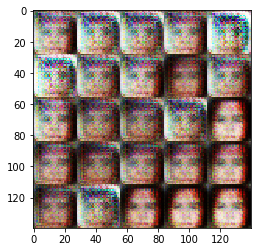

Epoch 1/1   Disc Loss: 0.48072    Gen Loss: 2.38662


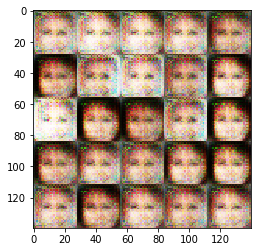

Epoch 1/1   Disc Loss: 1.04132    Gen Loss: 0.60003


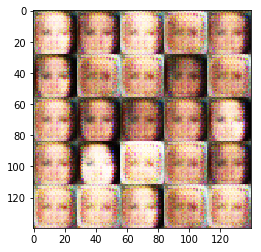

Epoch 1/1   Disc Loss: 0.87663    Gen Loss: 4.60617


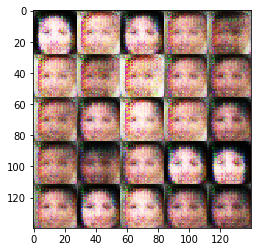

Epoch 1/1   Disc Loss: 0.38260    Gen Loss: 1.58823


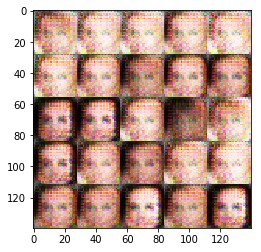

Epoch 1/1   Disc Loss: 0.39491    Gen Loss: 1.73652


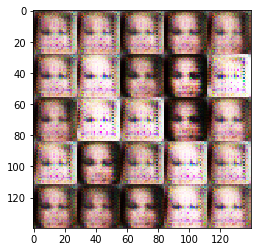

Epoch 1/1   Disc Loss: 3.30285    Gen Loss: 0.06357


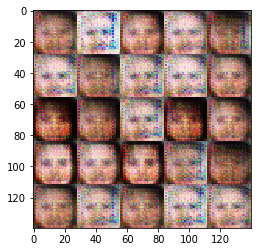

Epoch 1/1   Disc Loss: 0.52302    Gen Loss: 1.32668


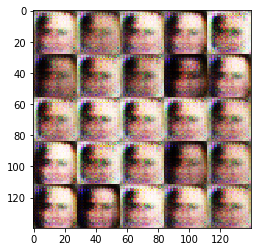

Epoch 1/1   Disc Loss: 1.81480    Gen Loss: 0.88416


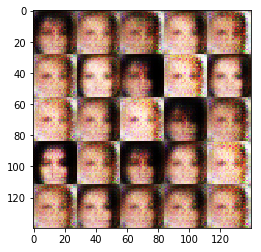

Epoch 1/1   Disc Loss: 0.34643    Gen Loss: 2.63009


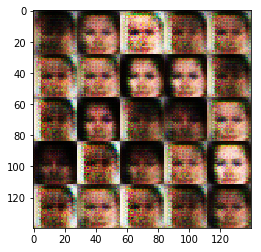

Epoch 1/1   Disc Loss: 0.58087    Gen Loss: 1.41592


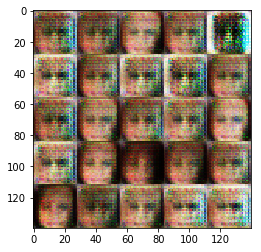

Epoch 1/1   Disc Loss: 1.19505    Gen Loss: 0.54586


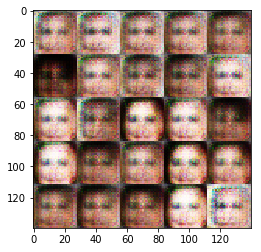

Epoch 1/1   Disc Loss: 1.19271    Gen Loss: 0.54179


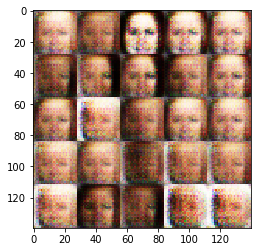

Epoch 1/1   Disc Loss: 0.60995    Gen Loss: 3.14252


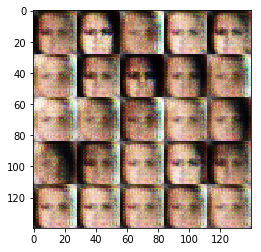

Epoch 1/1   Disc Loss: 0.48009    Gen Loss: 1.38395


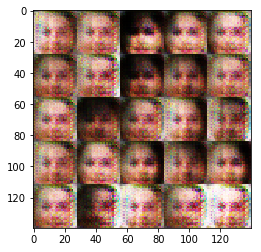

Epoch 1/1   Disc Loss: 0.67544    Gen Loss: 1.02606


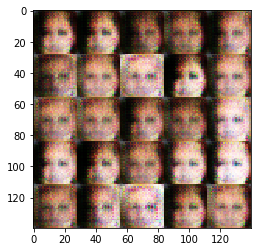

Epoch 1/1   Disc Loss: 0.38859    Gen Loss: 1.59634


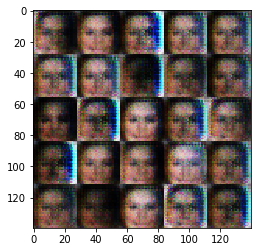

Epoch 1/1   Disc Loss: 1.22680    Gen Loss: 0.44140


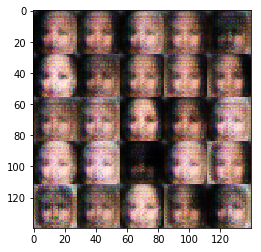

Epoch 1/1   Disc Loss: 0.95344    Gen Loss: 4.99338


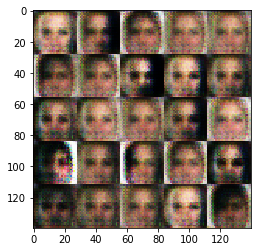

Epoch 1/1   Disc Loss: 0.35853    Gen Loss: 1.64437


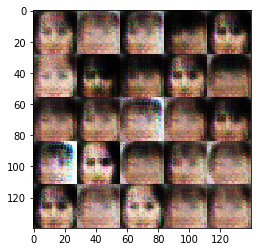

Epoch 1/1   Disc Loss: 0.29963    Gen Loss: 2.05958


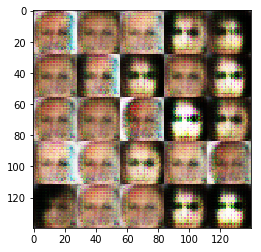

Epoch 1/1   Disc Loss: 1.05234    Gen Loss: 0.50195


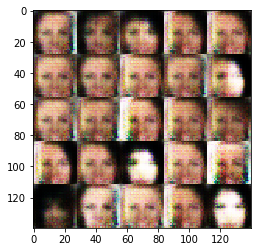

Epoch 1/1   Disc Loss: 0.58462    Gen Loss: 0.97877


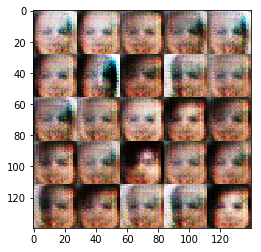

Epoch 1/1   Disc Loss: 1.37976    Gen Loss: 0.45265


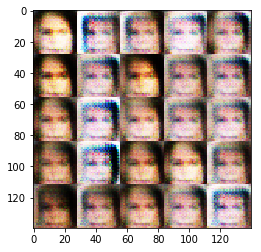

Epoch 1/1   Disc Loss: 0.63767    Gen Loss: 1.24709


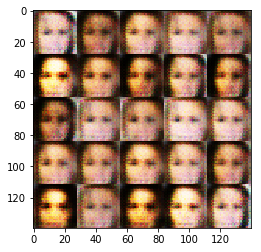

Epoch 1/1   Disc Loss: 0.35606    Gen Loss: 1.86586


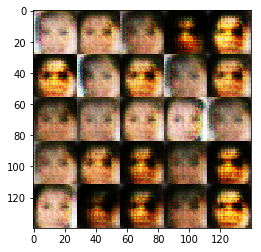

Epoch 1/1   Disc Loss: 0.80302    Gen Loss: 0.78400


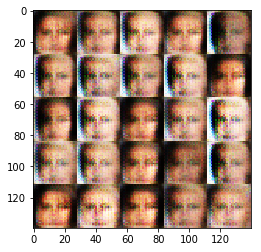

Epoch 1/1   Disc Loss: 0.55485    Gen Loss: 5.18226


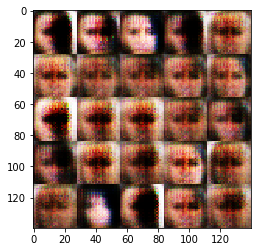

Epoch 1/1   Disc Loss: 0.86472    Gen Loss: 5.49850


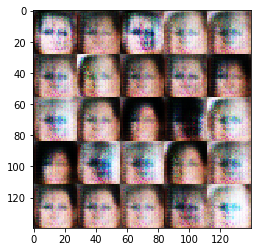

Epoch 1/1   Disc Loss: 0.92810    Gen Loss: 0.88772


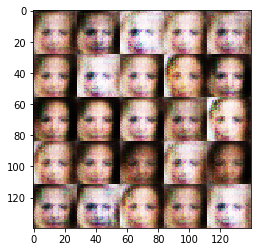

Epoch 1/1   Disc Loss: 0.33205    Gen Loss: 2.30304


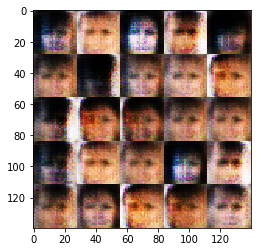

Epoch 1/1   Disc Loss: 0.51185    Gen Loss: 4.82894


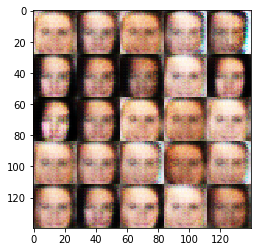

Epoch 1/1   Disc Loss: 0.21392    Gen Loss: 3.47388


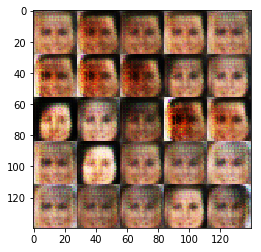

Epoch 1/1   Disc Loss: 0.18738    Gen Loss: 2.59181


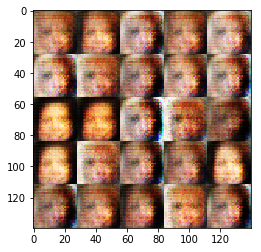

Epoch 1/1   Disc Loss: 0.22348    Gen Loss: 2.10275


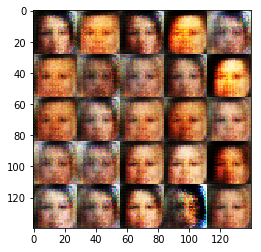

Epoch 1/1   Disc Loss: 0.18675    Gen Loss: 2.25156


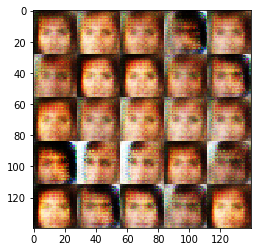

Epoch 1/1   Disc Loss: 0.48087    Gen Loss: 1.50399


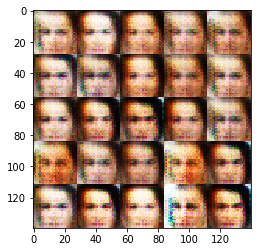

Epoch 1/1   Disc Loss: 0.06869    Gen Loss: 5.50302


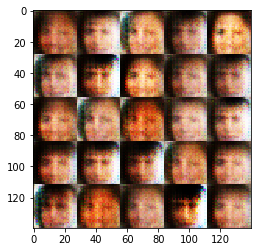

Epoch 1/1   Disc Loss: 0.85866    Gen Loss: 0.81687


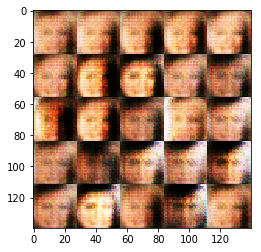

Epoch 1/1   Disc Loss: 0.97609    Gen Loss: 4.61931


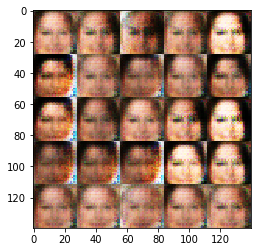

Epoch 1/1   Disc Loss: 0.33977    Gen Loss: 1.66856


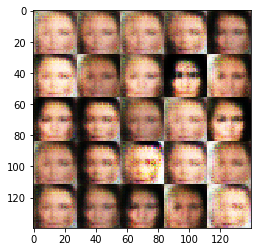

Epoch 1/1   Disc Loss: 0.38081    Gen Loss: 1.69621


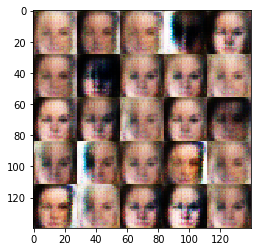

Epoch 1/1   Disc Loss: 0.36225    Gen Loss: 3.62439


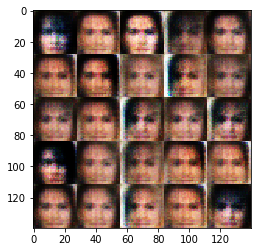

Epoch 1/1   Disc Loss: 0.44580    Gen Loss: 1.52643


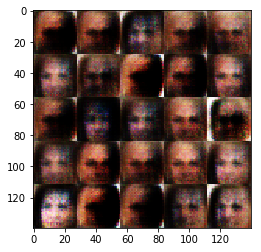

Epoch 1/1   Disc Loss: 1.16649    Gen Loss: 10.16178


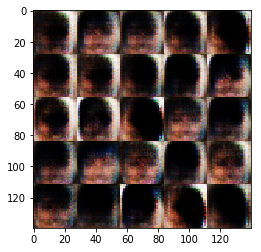

Epoch 1/1   Disc Loss: 0.28368    Gen Loss: 1.74032


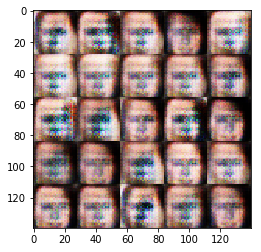

Epoch 1/1   Disc Loss: 1.28675    Gen Loss: 0.85719


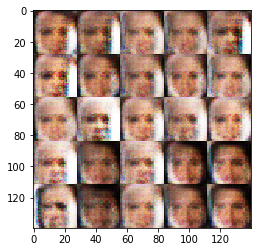

Epoch 1/1   Disc Loss: 1.10979    Gen Loss: 0.66677


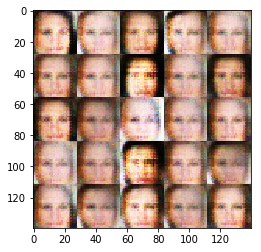

Epoch 1/1   Disc Loss: 0.32373    Gen Loss: 2.08616


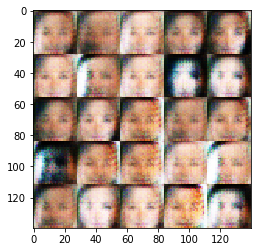

Epoch 1/1   Disc Loss: 0.47942    Gen Loss: 1.20721


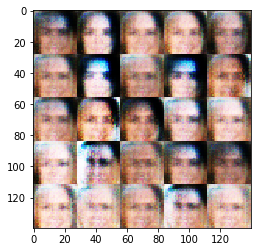

Epoch 1/1   Disc Loss: 0.48287    Gen Loss: 1.59707


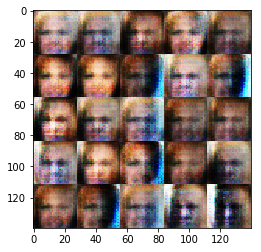

Epoch 1/1   Disc Loss: 0.65475    Gen Loss: 0.98610


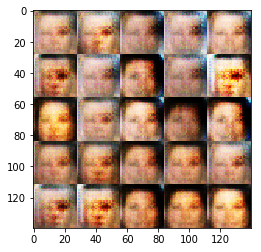

Epoch 1/1   Disc Loss: 0.23086    Gen Loss: 1.85780


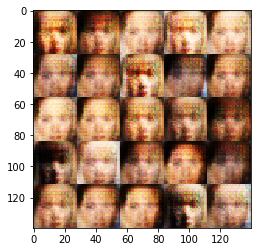

Epoch 1/1   Disc Loss: 0.28557    Gen Loss: 1.88584


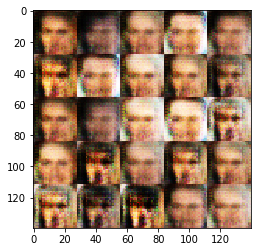

Epoch 1/1   Disc Loss: 0.35912    Gen Loss: 1.75395


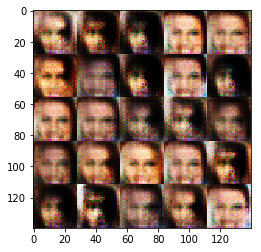

Epoch 1/1   Disc Loss: 0.19513    Gen Loss: 2.55799


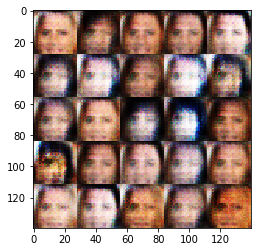

Epoch 1/1   Disc Loss: 0.13965    Gen Loss: 4.41603


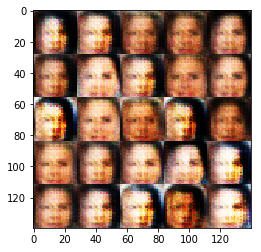

Epoch 1/1   Disc Loss: 1.46616    Gen Loss: 0.41356


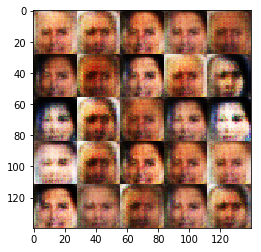

Epoch 1/1   Disc Loss: 1.28698    Gen Loss: 0.54018


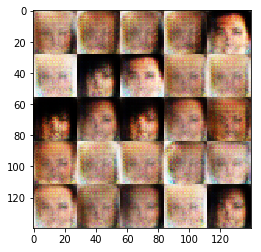

Epoch 1/1   Disc Loss: 0.14776    Gen Loss: 2.44741


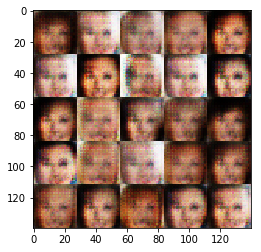

Epoch 1/1   Disc Loss: 0.66494    Gen Loss: 1.00330


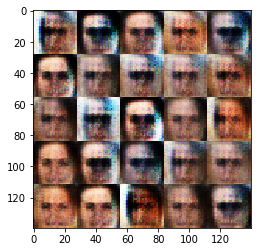

Epoch 1/1   Disc Loss: 0.89712    Gen Loss: 0.70969


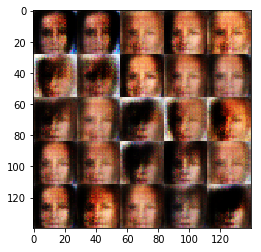

Epoch 1/1   Disc Loss: 0.22748    Gen Loss: 2.18608


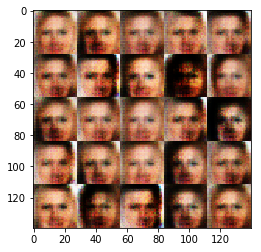

Epoch 1/1   Disc Loss: 0.43643    Gen Loss: 1.34672


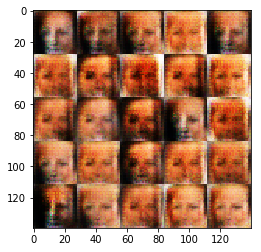

Epoch 1/1   Disc Loss: 0.41623    Gen Loss: 5.35417


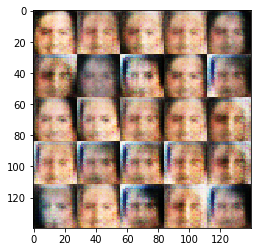

Epoch 1/1   Disc Loss: 1.75892    Gen Loss: 0.30431


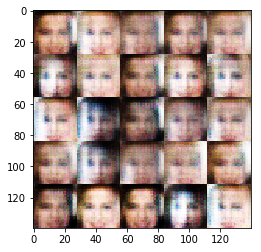

Epoch 1/1   Disc Loss: 0.75599    Gen Loss: 1.04495


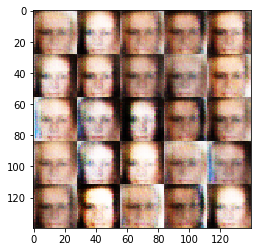

Epoch 1/1   Disc Loss: 0.31396    Gen Loss: 2.30887


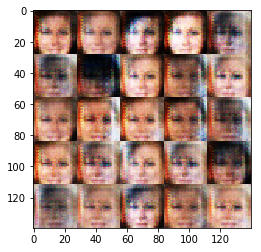

Epoch 1/1   Disc Loss: 0.43677    Gen Loss: 1.71441


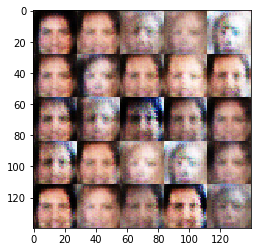

Epoch 1/1   Disc Loss: 0.51228    Gen Loss: 5.44180


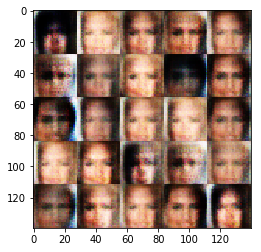

Epoch 1/1   Disc Loss: 0.11424    Gen Loss: 2.79195


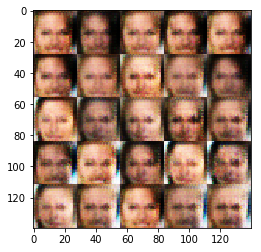

Epoch 1/1   Disc Loss: 0.16959    Gen Loss: 2.37417


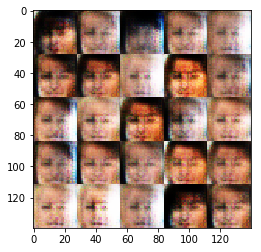

Epoch 1/1   Disc Loss: 0.28588    Gen Loss: 1.80846


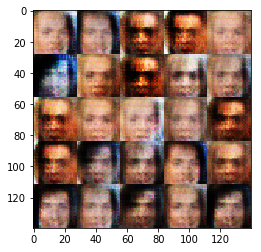

Epoch 1/1   Disc Loss: 0.28922    Gen Loss: 2.49369


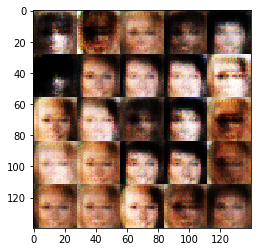

Epoch 1/1   Disc Loss: 0.82102    Gen Loss: 0.98641


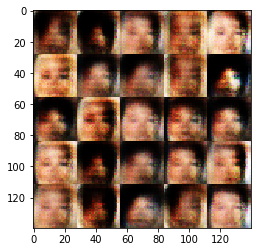

Epoch 1/1   Disc Loss: 0.07352    Gen Loss: 3.22799


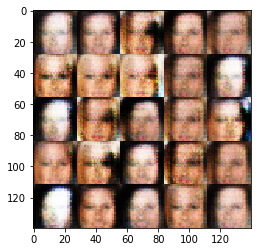

Epoch 1/1   Disc Loss: 0.15271    Gen Loss: 3.87238


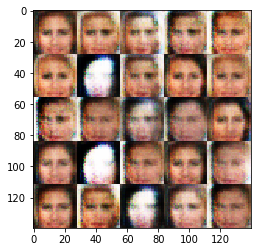

Epoch 1/1   Disc Loss: 0.52501    Gen Loss: 3.38608


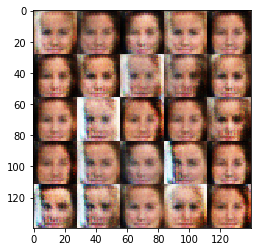

Epoch 1/1   Disc Loss: 1.40720    Gen Loss: 0.47368


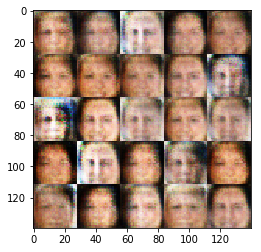

Epoch 1/1   Disc Loss: 1.32255    Gen Loss: 0.48632


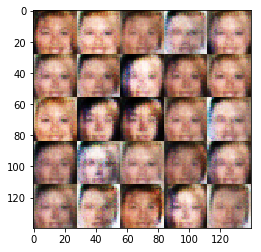

Epoch 1/1   Disc Loss: 0.18585    Gen Loss: 3.79736


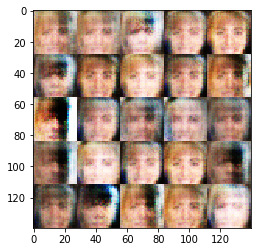

Epoch 1/1   Disc Loss: 0.15055    Gen Loss: 4.67867


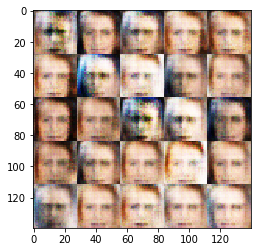

Epoch 1/1   Disc Loss: 0.37999    Gen Loss: 3.24588


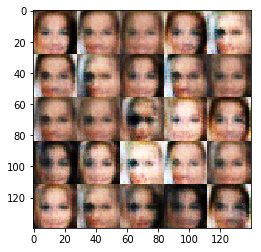

Epoch 1/1   Disc Loss: 2.67833    Gen Loss: 7.39450


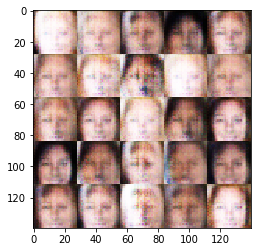

Epoch 1/1   Disc Loss: 0.41281    Gen Loss: 2.16968


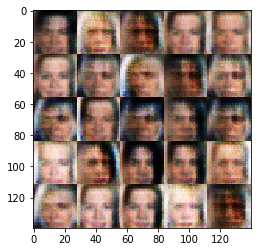

Epoch 1/1   Disc Loss: 0.36496    Gen Loss: 1.74374


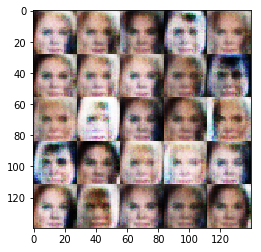

Epoch 1/1   Disc Loss: 0.74924    Gen Loss: 0.83602


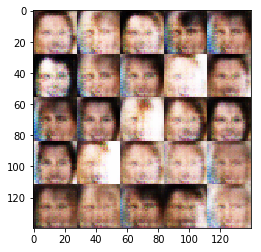

Epoch 1/1   Disc Loss: 0.79071    Gen Loss: 1.11298


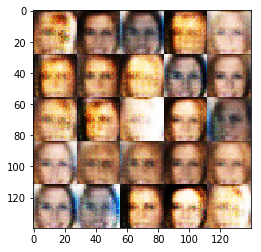

Epoch 1/1   Disc Loss: 3.09079    Gen Loss: 0.05291


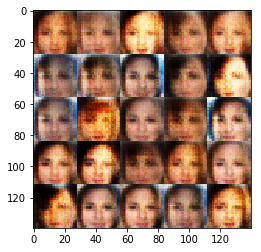

Epoch 1/1   Disc Loss: 0.65604    Gen Loss: 1.29883


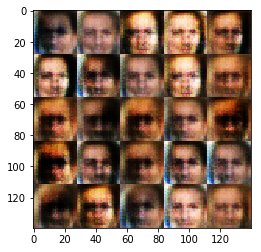

Epoch 1/1   Disc Loss: 0.20838    Gen Loss: 3.10838


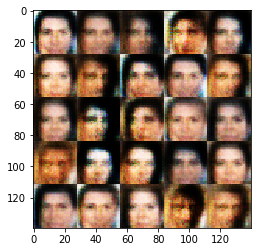

Epoch 1/1   Disc Loss: 0.11959    Gen Loss: 5.09692


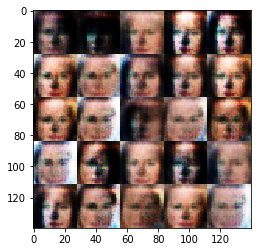

Epoch 1/1   Disc Loss: 1.11090    Gen Loss: 6.10580


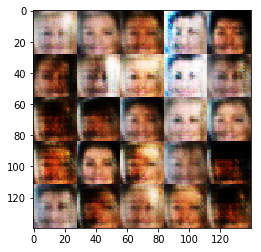

Epoch 1/1   Disc Loss: 0.49650    Gen Loss: 1.35712


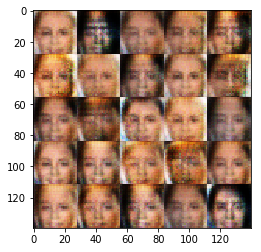

Epoch 1/1   Disc Loss: 0.17865    Gen Loss: 2.55932


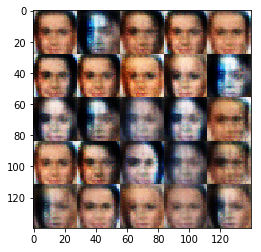

Epoch 1/1   Disc Loss: 0.32709    Gen Loss: 4.20774


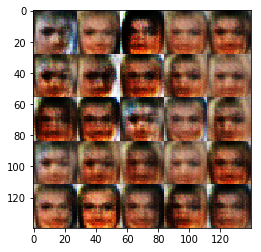

Epoch 1/1   Disc Loss: 0.46014    Gen Loss: 1.25952


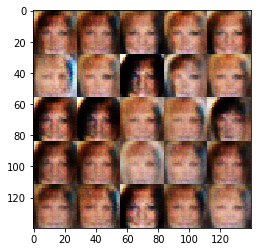

Epoch 1/1   Disc Loss: 1.76859    Gen Loss: 0.33720


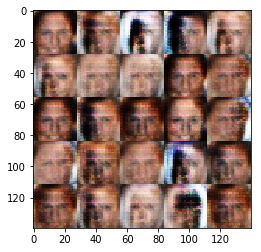

Epoch 1/1   Disc Loss: 0.14515    Gen Loss: 3.69116


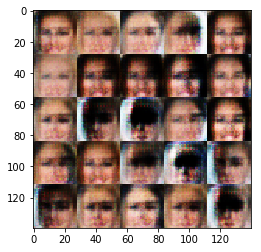

Epoch 1/1   Disc Loss: 0.29883    Gen Loss: 3.30921


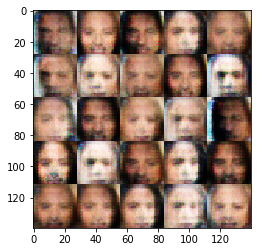

Epoch 1/1   Disc Loss: 0.57155    Gen Loss: 0.96597


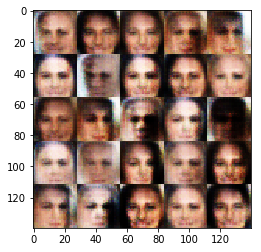

Epoch 1/1   Disc Loss: 0.33027    Gen Loss: 2.38375


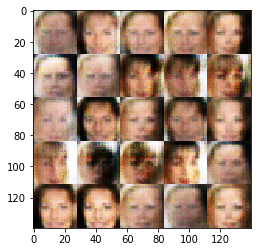

Epoch 1/1   Disc Loss: 0.29262    Gen Loss: 1.86386


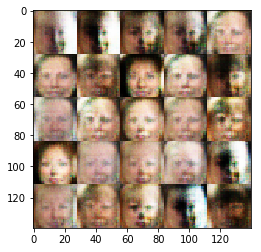

Epoch 1/1   Disc Loss: 0.48948    Gen Loss: 3.15641


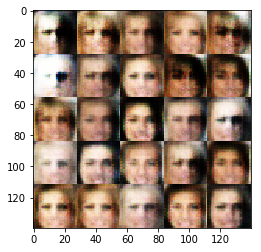

Epoch 1/1   Disc Loss: 1.16041    Gen Loss: 6.82457


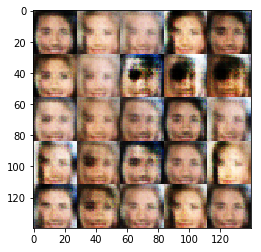

Epoch 1/1   Disc Loss: 0.13238    Gen Loss: 2.54584


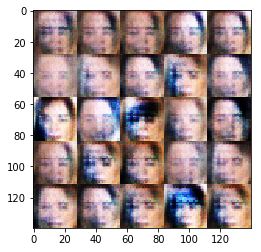

Epoch 1/1   Disc Loss: 0.63746    Gen Loss: 0.94640


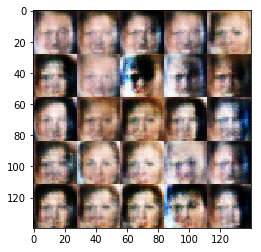

Epoch 1/1   Disc Loss: 0.86529    Gen Loss: 0.66981


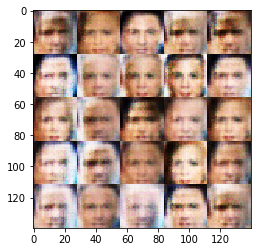

Epoch 1/1   Disc Loss: 0.97710    Gen Loss: 0.61211


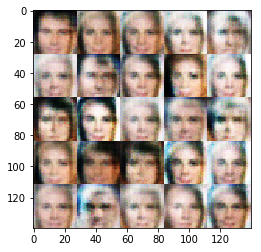

Epoch 1/1   Disc Loss: 0.18577    Gen Loss: 2.21153


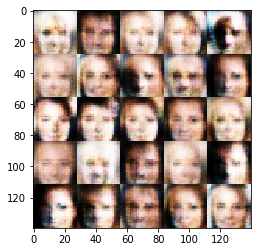

Epoch 1/1   Disc Loss: 0.27179    Gen Loss: 2.81305


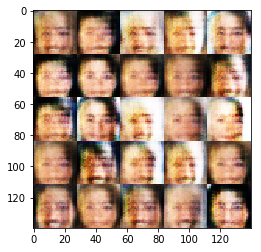

Epoch 1/1   Disc Loss: 0.20766    Gen Loss: 4.02279


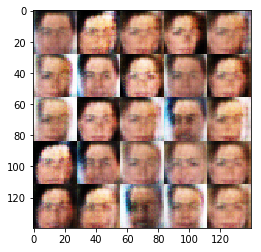

Epoch 1/1   Disc Loss: 0.12131    Gen Loss: 2.75554


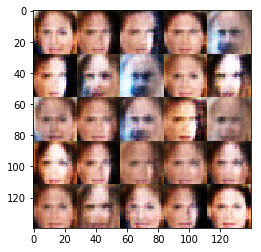

Epoch 1/1   Disc Loss: 1.18453    Gen Loss: 0.58336


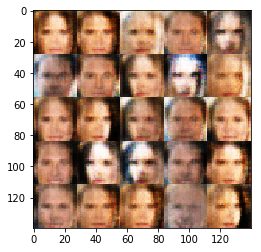

Epoch 1/1   Disc Loss: 0.67148    Gen Loss: 0.87365


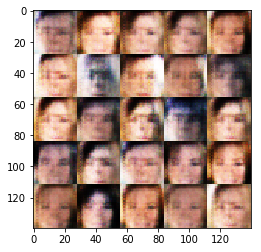

Epoch 1/1   Disc Loss: 1.25935    Gen Loss: 4.97839


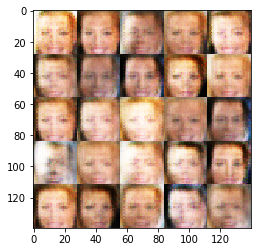

Epoch 1/1   Disc Loss: 0.22568    Gen Loss: 2.80359


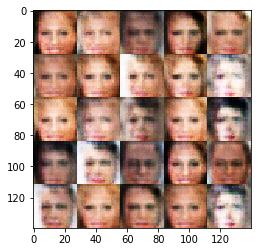

Epoch 1/1   Disc Loss: 0.65438    Gen Loss: 0.96826


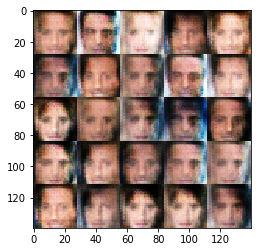

Epoch 1/1   Disc Loss: 0.34247    Gen Loss: 1.66618


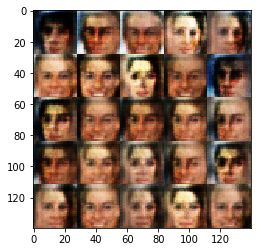

Epoch 1/1   Disc Loss: 0.26938    Gen Loss: 1.76504


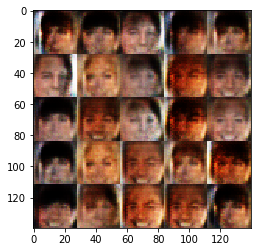

Epoch 1/1   Disc Loss: 4.70880    Gen Loss: 0.01683


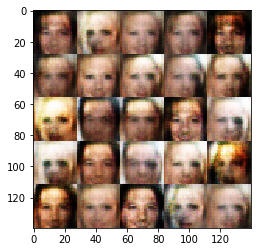

Epoch 1/1   Disc Loss: 0.41622    Gen Loss: 4.57768


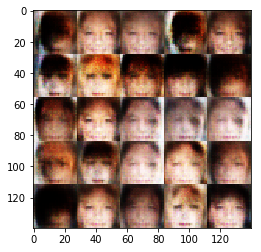

Epoch 1/1   Disc Loss: 0.71718    Gen Loss: 3.41947


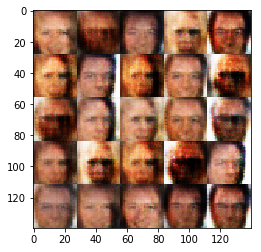

Epoch 1/1   Disc Loss: 0.32152    Gen Loss: 3.04971


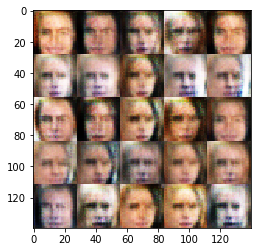

Epoch 1/1   Disc Loss: 0.19272    Gen Loss: 2.19769


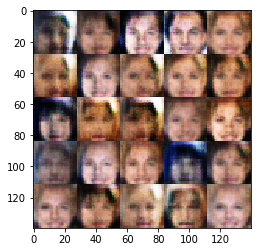

Epoch 1/1   Disc Loss: 0.22922    Gen Loss: 1.96698


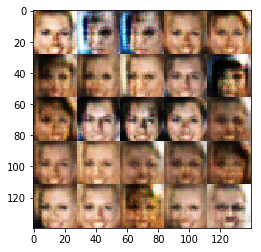

Epoch 1/1   Disc Loss: 0.23850    Gen Loss: 2.14536


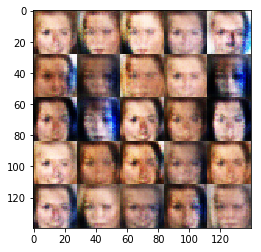

Epoch 1/1   Disc Loss: 0.82986    Gen Loss: 4.34038


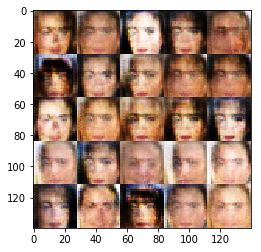

Epoch 1/1   Disc Loss: 0.18759    Gen Loss: 2.66962


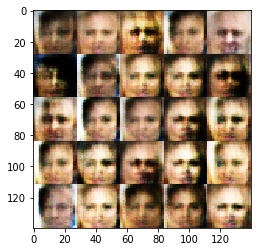

Epoch 1/1   Disc Loss: 0.15972    Gen Loss: 5.89939


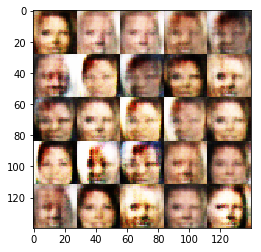

Epoch 1/1   Disc Loss: 0.39036    Gen Loss: 1.62279


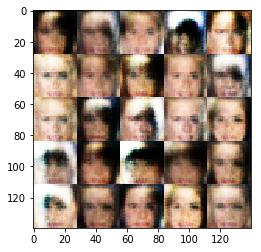

Epoch 1/1   Disc Loss: 0.11112    Gen Loss: 2.71507


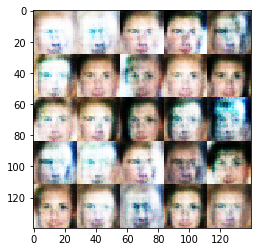

Epoch 1/1   Disc Loss: 0.52415    Gen Loss: 1.33421


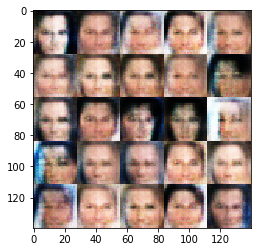

Epoch 1/1   Disc Loss: 0.98362    Gen Loss: 5.12880


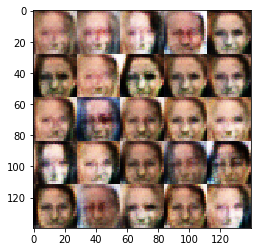

Epoch 1/1   Disc Loss: 0.54653    Gen Loss: 1.06465


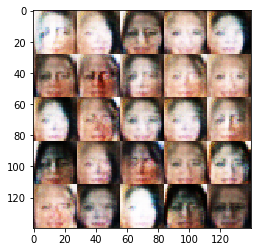

Epoch 1/1   Disc Loss: 0.04070    Gen Loss: 4.21788


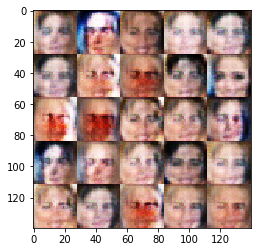

Epoch 1/1   Disc Loss: 0.14348    Gen Loss: 2.50287


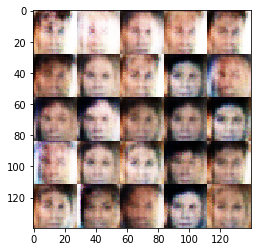

Epoch 1/1   Disc Loss: 0.31613    Gen Loss: 1.68680


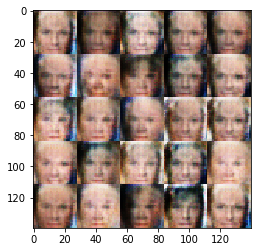

Epoch 1/1   Disc Loss: 0.59657    Gen Loss: 1.16864


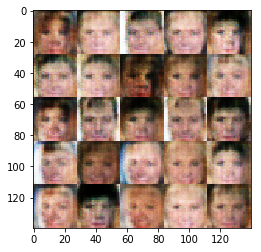

Epoch 1/1   Disc Loss: 1.29479    Gen Loss: 0.44134


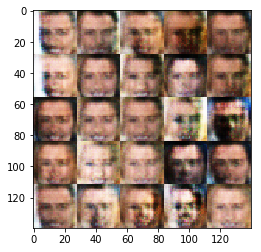

Epoch 1/1   Disc Loss: 2.06206    Gen Loss: 5.30085


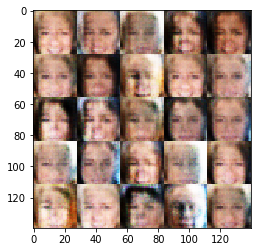

Epoch 1/1   Disc Loss: 0.98075    Gen Loss: 0.57058


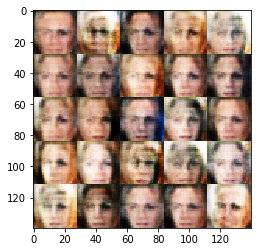

Epoch 1/1   Disc Loss: 0.22384    Gen Loss: 2.56544


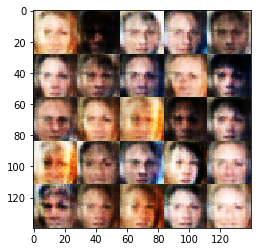

Epoch 1/1   Disc Loss: 0.53067    Gen Loss: 1.18474


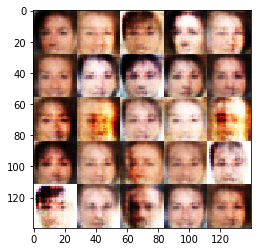

Epoch 1/1   Disc Loss: 0.50588    Gen Loss: 4.12734


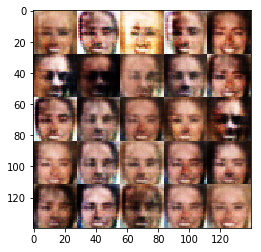

Epoch 1/1   Disc Loss: 0.31945    Gen Loss: 2.39669


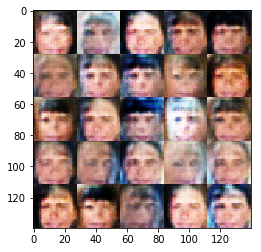

Epoch 1/1   Disc Loss: 0.14328    Gen Loss: 2.84119


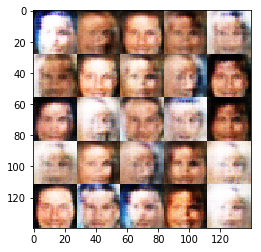

Epoch 1/1   Disc Loss: 0.32675    Gen Loss: 2.82340


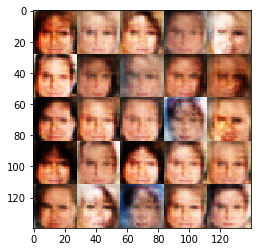

Epoch 1/1   Disc Loss: 0.19499    Gen Loss: 2.02306


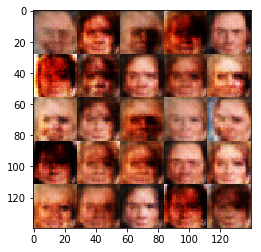

Epoch 1/1   Disc Loss: 0.28620    Gen Loss: 2.05740


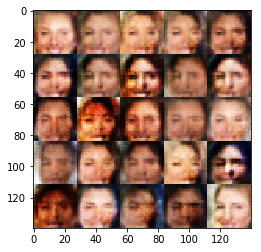

Epoch 1/1   Disc Loss: 0.75869    Gen Loss: 0.87330


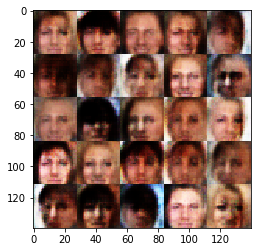

Epoch 1/1   Disc Loss: 0.35798    Gen Loss: 1.36352


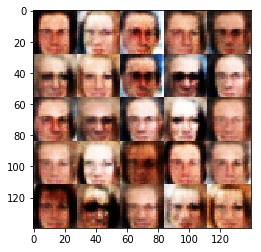

Epoch 1/1   Disc Loss: 0.17412    Gen Loss: 3.65670


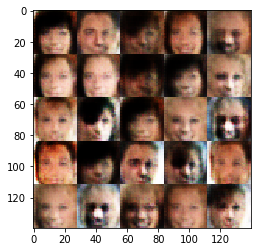

Epoch 1/1   Disc Loss: 0.37244    Gen Loss: 1.57402


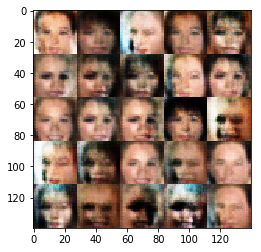

Epoch 1/1   Disc Loss: 0.43592    Gen Loss: 1.29656


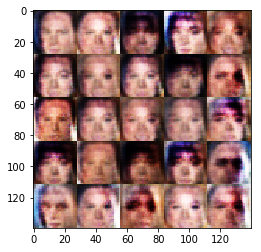

Epoch 1/1   Disc Loss: 0.10133    Gen Loss: 2.92852


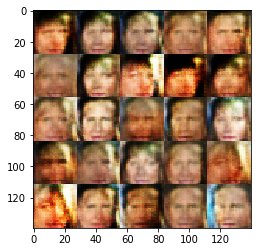

Epoch 1/1   Disc Loss: 2.63660    Gen Loss: 0.11066


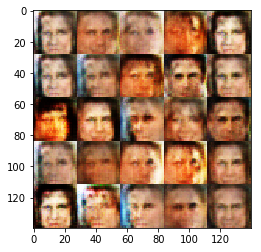

Epoch 1/1   Disc Loss: 0.61576    Gen Loss: 1.13777


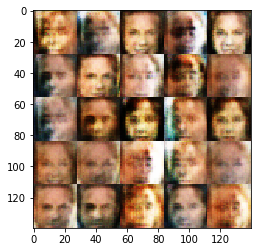

Epoch 1/1   Disc Loss: 0.48868    Gen Loss: 2.14116


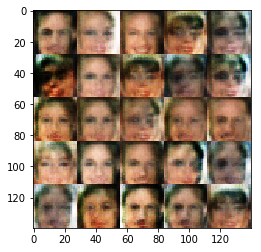

Epoch 1/1   Disc Loss: 0.25255    Gen Loss: 1.93435


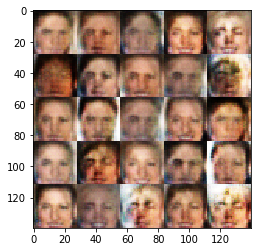

Epoch 1/1   Disc Loss: 0.35017    Gen Loss: 3.68119


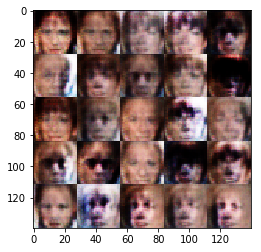

Epoch 1/1   Disc Loss: 0.04398    Gen Loss: 4.37390


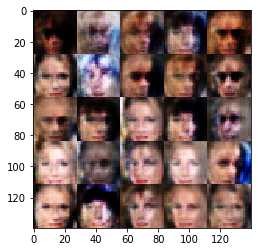

Epoch 1/1   Disc Loss: 1.12557    Gen Loss: 0.45067


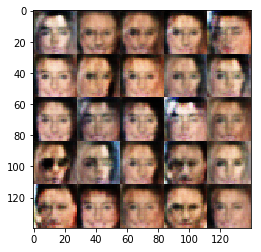

Epoch 1/1   Disc Loss: 0.61305    Gen Loss: 1.15190


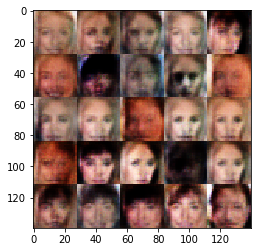

Epoch 1/1   Disc Loss: 0.41880    Gen Loss: 1.30399


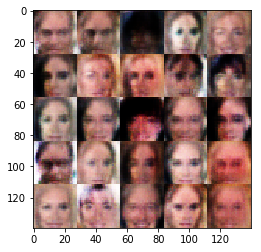

Epoch 1/1   Disc Loss: 0.69301    Gen Loss: 0.82979


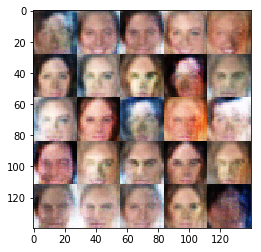

Epoch 1/1   Disc Loss: 0.34682    Gen Loss: 1.48652


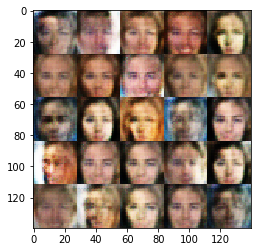

Epoch 1/1   Disc Loss: 0.26496    Gen Loss: 1.86306


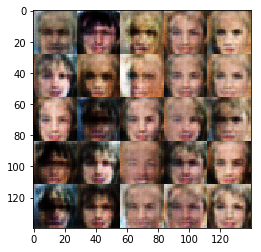

Epoch 1/1   Disc Loss: 0.10140    Gen Loss: 2.60217


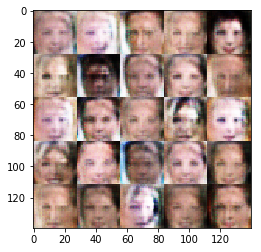

Epoch 1/1   Disc Loss: 0.16443    Gen Loss: 2.19510


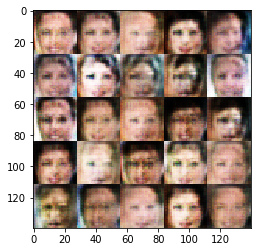

Epoch 1/1   Disc Loss: 0.33075    Gen Loss: 2.12440


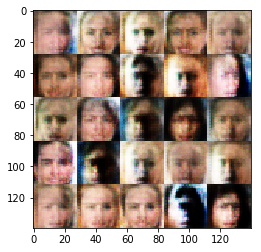

Epoch 1/1   Disc Loss: 1.28772    Gen Loss: 0.35761


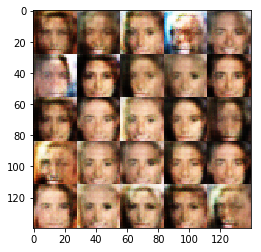

Epoch 1/1   Disc Loss: 0.27225    Gen Loss: 2.12323


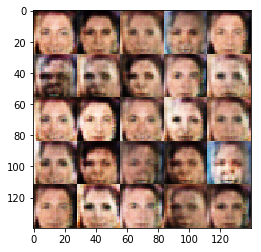

Epoch 1/1   Disc Loss: 0.19215    Gen Loss: 2.85406


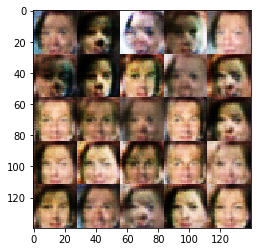

Epoch 1/1   Disc Loss: 0.12945    Gen Loss: 2.63291


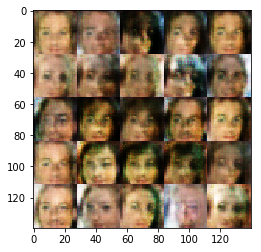

Epoch 1/1   Disc Loss: 0.20695    Gen Loss: 2.25291


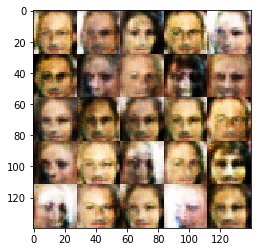

Epoch 1/1   Disc Loss: 0.25740    Gen Loss: 1.95405


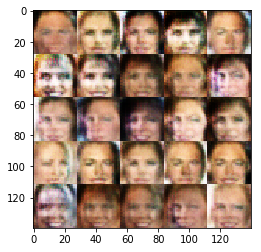

Epoch 1/1   Disc Loss: 1.43131    Gen Loss: 0.33051


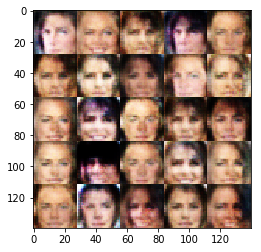

Epoch 1/1   Disc Loss: 0.39515    Gen Loss: 1.61659


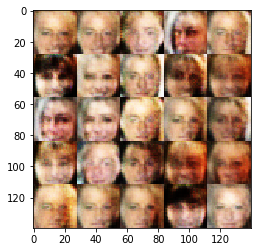

Epoch 1/1   Disc Loss: 0.37316    Gen Loss: 1.29025


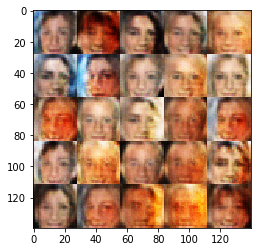

Epoch 1/1   Disc Loss: 0.11296    Gen Loss: 2.58125


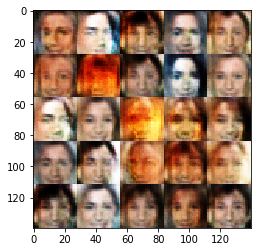

Epoch 1/1   Disc Loss: 0.35715    Gen Loss: 1.47481


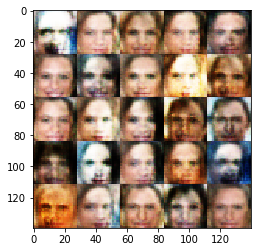

Epoch 1/1   Disc Loss: 0.05159    Gen Loss: 3.40481


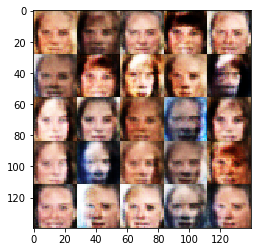

Epoch 1/1   Disc Loss: 0.34024    Gen Loss: 1.96840


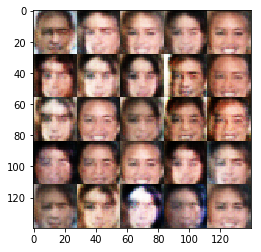

Epoch 1/1   Disc Loss: 1.57025    Gen Loss: 0.35253


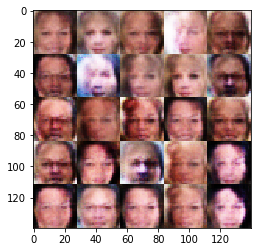

Epoch 1/1   Disc Loss: 0.14445    Gen Loss: 2.66455


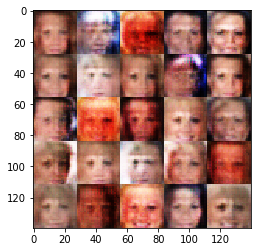

Epoch 1/1   Disc Loss: 0.18895    Gen Loss: 3.53766


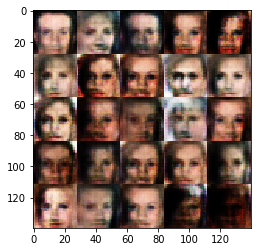

Epoch 1/1   Disc Loss: 0.40128    Gen Loss: 1.41516


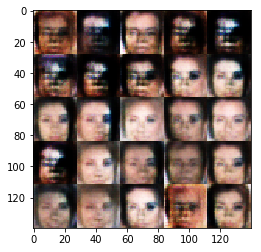

Epoch 1/1   Disc Loss: 0.18479    Gen Loss: 2.49072


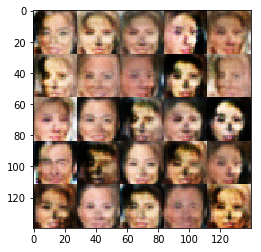

Epoch 1/1   Disc Loss: 1.78755    Gen Loss: 0.40201


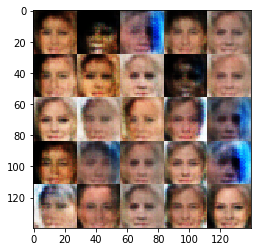

Epoch 1/1   Disc Loss: 0.09748    Gen Loss: 3.84174


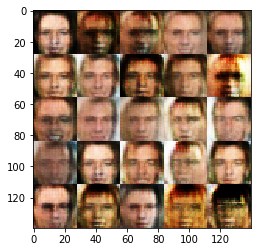

Epoch 1/1   Disc Loss: 0.55238    Gen Loss: 2.82983


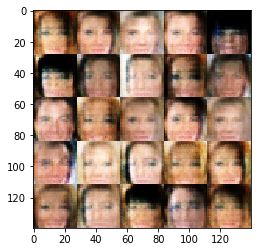

Epoch 1/1   Disc Loss: 0.43283    Gen Loss: 1.23501


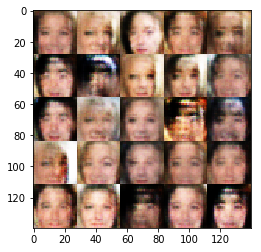

Epoch 1/1   Disc Loss: 0.05843    Gen Loss: 3.40509


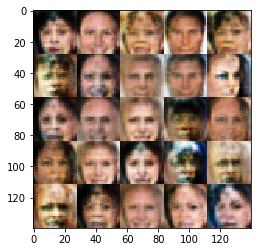

Epoch 1/1   Disc Loss: 0.47536    Gen Loss: 1.31112


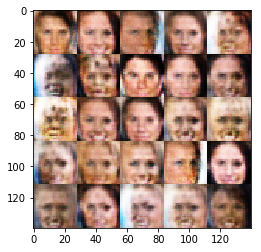

Epoch 1/1   Disc Loss: 0.93962    Gen Loss: 0.73123


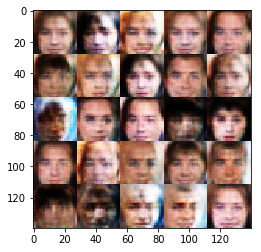

Epoch 1/1   Disc Loss: 1.54782    Gen Loss: 0.32283


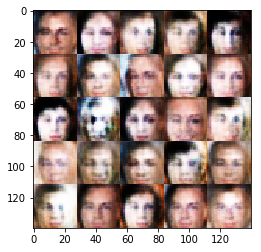

Epoch 1/1   Disc Loss: 0.74232    Gen Loss: 2.79736


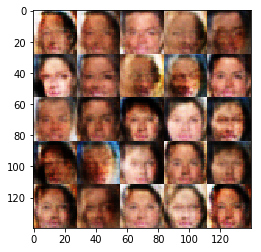

Epoch 1/1   Disc Loss: 0.28315    Gen Loss: 2.14006


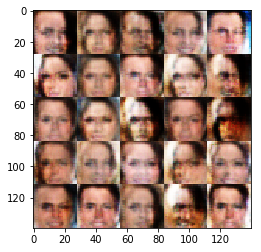

Epoch 1/1   Disc Loss: 0.18121    Gen Loss: 2.12173


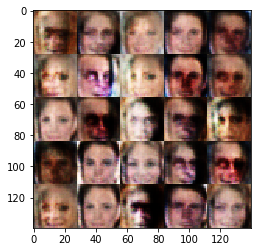

Epoch 1/1   Disc Loss: 0.33135    Gen Loss: 2.30624


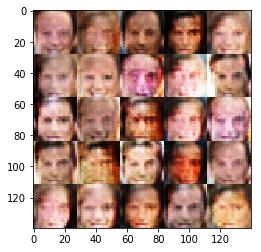

Epoch 1/1   Disc Loss: 0.36435    Gen Loss: 1.41192


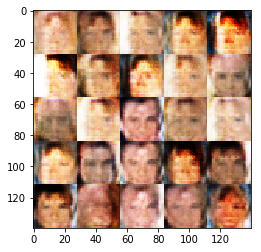

Epoch 1/1   Disc Loss: 1.18995    Gen Loss: 0.47698


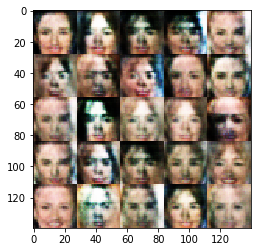

Epoch 1/1   Disc Loss: 0.31032    Gen Loss: 2.03906


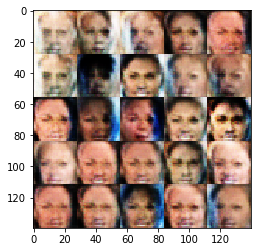

Epoch 1/1   Disc Loss: 0.57181    Gen Loss: 1.00739


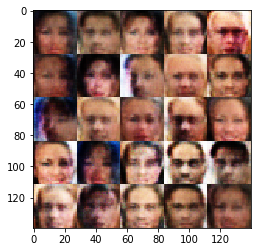

Epoch 1/1   Disc Loss: 2.21709    Gen Loss: 0.21391


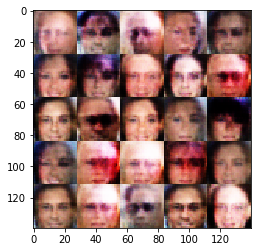

Epoch 1/1   Disc Loss: 0.37218    Gen Loss: 1.49224


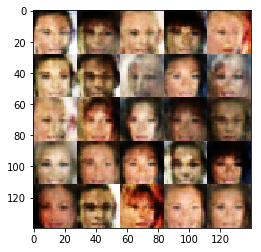

Epoch 1/1   Disc Loss: 0.11036    Gen Loss: 2.59145


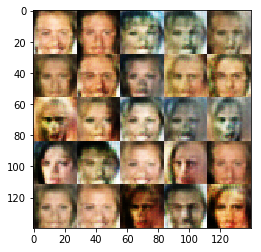

Epoch 1/1   Disc Loss: 0.52389    Gen Loss: 1.01269


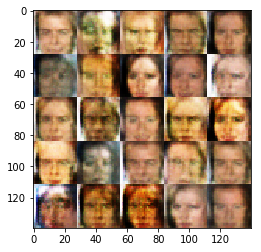

Epoch 1/1   Disc Loss: 0.01893    Gen Loss: 5.07520


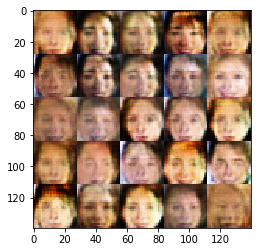

Epoch 1/1   Disc Loss: 0.40898    Gen Loss: 1.47659


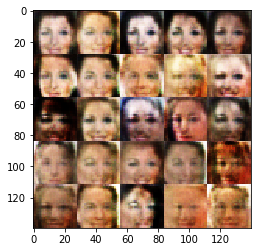

Epoch 1/1   Disc Loss: 0.17954    Gen Loss: 3.32033


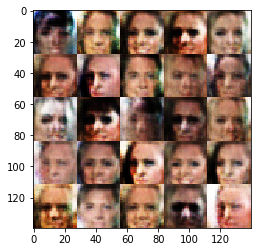

Epoch 1/1   Disc Loss: 0.40566    Gen Loss: 1.40686


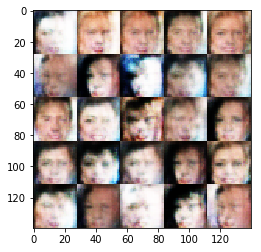

Epoch 1/1   Disc Loss: 2.23361    Gen Loss: 0.17800


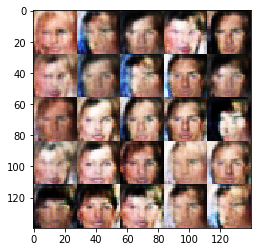

Epoch 1/1   Disc Loss: 0.52881    Gen Loss: 3.96653


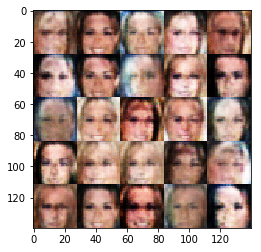

Epoch 1/1   Disc Loss: 0.63515    Gen Loss: 1.05578


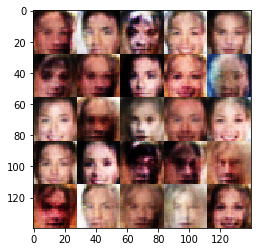

Epoch 1/1   Disc Loss: 1.85460    Gen Loss: 6.60682


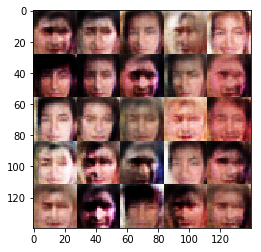

Epoch 1/1   Disc Loss: 0.24025    Gen Loss: 1.91420


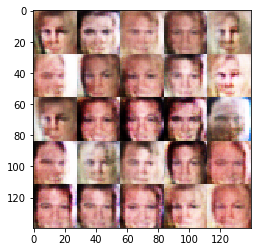

Epoch 1/1   Disc Loss: 0.08835    Gen Loss: 3.82384


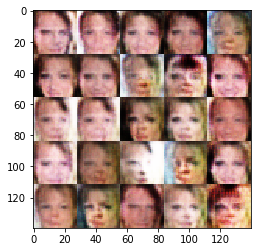

Epoch 1/1   Disc Loss: 3.45319    Gen Loss: 0.04331


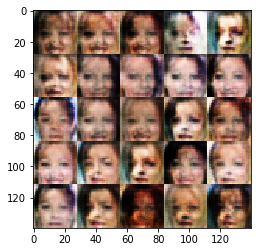

Epoch 1/1   Disc Loss: 0.30269    Gen Loss: 1.54736


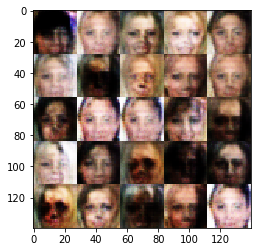

Epoch 1/1   Disc Loss: 3.14200    Gen Loss: 7.31121


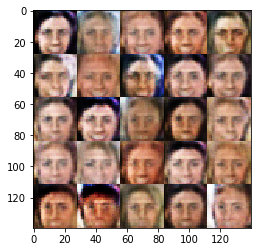

Epoch 1/1   Disc Loss: 0.18563    Gen Loss: 2.03571


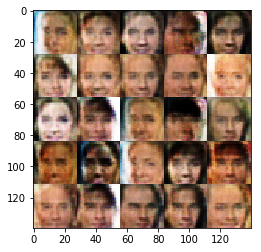

Epoch 1/1   Disc Loss: 0.10994    Gen Loss: 3.74336


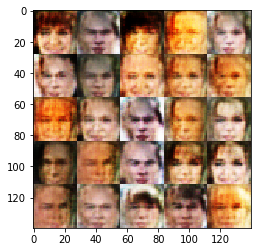

Epoch 1/1   Disc Loss: 0.68933    Gen Loss: 0.81894


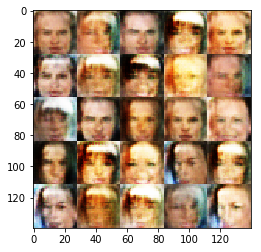

Epoch 1/1   Disc Loss: 0.21732    Gen Loss: 2.11041


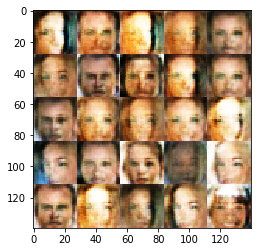

Epoch 1/1   Disc Loss: 0.00342    Gen Loss: 7.32875


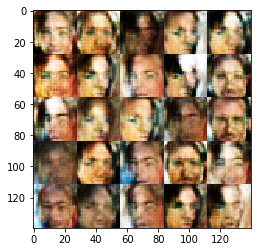

Epoch 1/1   Disc Loss: 0.28750    Gen Loss: 1.69608


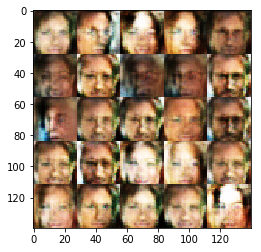

Epoch 1/1   Disc Loss: 0.42835    Gen Loss: 1.49532


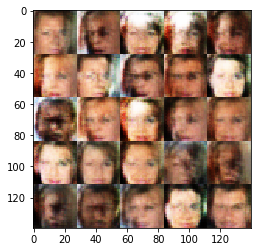

Epoch 1/1   Disc Loss: 0.71080    Gen Loss: 0.82465


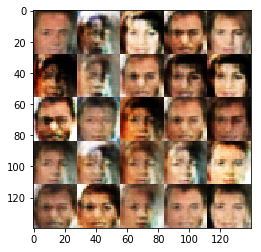

Epoch 1/1   Disc Loss: 0.10723    Gen Loss: 2.84320


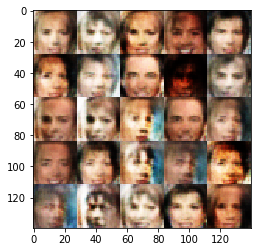

Epoch 1/1   Disc Loss: 0.59075    Gen Loss: 1.52561


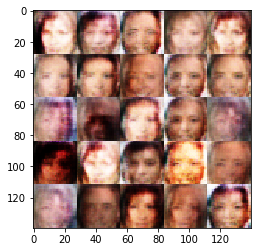

In [ ]:
batch_size = 64
z_dim = 100
learning_rate = 0.0001
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.